<center>
<h4>Universidad Nacional de Córdoba - Facultad de Matemática, Astronomía, Física y Computación</h4>
<h3>Diplomatura en Ciencia de Datos, Aprendizaje Automático y sus Aplicaciones</h3>
 <h2>Mentoría: Clasificación diagnóstica de mamografías </h2>
</center>

<h3> Práctico I -  Análisis y Visualización de Datos<h3>
    <h4>Integrantes:Mario Agustín Sgró, Lucía Benítez, Germán Bertea y Carolina Díaz <h4>

Inicialmente, como en toda exploración de datos tenemos muy poca información *a priori* sobre el significado de los datos y tenemos que empezar por comprenderlos.

In [1]:
#!pip install pandas-profiling

In [2]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches
import seaborn as sns
import pandas_profiling as pp

plt.rcParams['figure.figsize'] = (200, 200)

In [3]:
if sns.__version__ != '0.9.0':
    print('Atención! utilizamos seaborn versión 0.9.0')

In [4]:
pd.options.display.max_columns = 200
#pd.options.display.max_colwidth = 100
pd.options.display.max_rows = 1000

Comenzamos la lectura del dataset:

In [5]:
dataframe = pd.read_csv('datos/Datos_Mamografias.csv',sep=',')
dataframe.head(3)

,Imagen,Age,View,Laterality,Dcm_1,Dcm_2,Dcm_3,Dcm_4,Dcm_5,Dcm_6,Dcm_7,Dcm_8,Dcm_9,Dcm_10,Dcm_11,Dcm_12,Dcm_13,Dcm_14,Dcm_15,Dcm_16,Dcm_17,Dcm_18,Dcm_19,Dcm_20,Dcm_21,Dcm_22,Dcm_23,Area,Promedio,Media,Desvio,Asimetria,Kurtosis,Moda,Desvio_L1,Desvio_L2,Desvio_L3,Asimetria_L1,Asimetria_L2,Asimetria_L3,promGradiente,Relacion,Relacion_L1,Relacion_L2,Relacion_L3,Relacion_L4,EP,EPBinaria,RelEntropia,Haralick_1,Haralick_2,Haralick_3,Haralick_4,Haralick_5,Haralick_6,Haralick_7,Haralick_8,Haralick_9,Haralick_10,Haralick_11,Haralick_12,Haralick_13,Haralick_14,Haralick_15,Haralick_16,Haralick_17,Haralick_18,Haralick_19,Haralick_20,Haralick_21,Haralick_22,Haralick_23,Haralick_24,Haralick_25,Haralick_26,Haralick_27,Haralick_28,Haralick_29,Haralick_30,Haralick_31,Haralick_32,Haralick_33,Haralick_34,Haralick_35,Haralick_36,Haralick_37,Haralick_38,Haralick_39,Haralick_40,Haralick_41,Haralick_42,Haralick_43,Haralick_44,Haralick_45,Haralick_46,Haralick_47,Haralick_48,Haralick_49,Haralick_50,Haralick_51,Haralick_52,DF1,DF2,DF3,DF4,DF5,DF6,DF7,DF8,DF9,DF10,DF11,DF12,DF13,DF14,DF15,DF16,DF17,DF18,DF19,DF20,DF21,DF22,DF23,DF24,DF25,DF26,DF27,DF28,DF29,DF30,DF31,DF32,DF33,DF34,DF35,DF36,DF37,DF38,DF39,DF40,DF41,DF42,DF43,DF44,DF45,DF46,DF47,DF48,DFb1,DFb2,DFb3,DFb4,DFb5,DFb6,DFb7,DFb8,DFb9,DFb10,DFb11,DFb12,DFb13,DFb14,DFb15,DFb16,DFb17,DFb18,DFb19,DFb20,DFb21,DFb22,DFb23,DFb24,DFb25,DFb26,DFb27,DFb28,DFb29,DFb30,DFb31,DFb32,DFb33,DFb34,DFb35,DFb36,DFb37,DFb38,DFb39,DFb40,DFb41,DFb42,DFb43,DFb44,DFb45,DFb46,DFb47,DFb48,ACR
0,Imagen_0.npy,47.0,CC,R,29.0,130.0,155.0,1115.0,RHODIUM,0.05,0.3,TUNGSTEN,54.0,58.5,700.0,621.0,1.073,-8.4,AUTOMATIC,AutoFilter,321.0,6.53,0.0172,0.531,2047.0,4096.0,NO,1906717.0,1204.431581,1108.0,651.401605,0.631631,-0.158630,771.0,582.461892,617.414299,571.626601,1.254898,0.340503,0.478727,26.263890,50.872416,30.246896,39.025868,57.284054,56.462588,0.769471,0.176043,0.012500,0.000003,29632.094980,0.965015,423492.945587,0.010546,2407.880580,1.664340e+06,12.237075,18.933134,8.625112e-07,8.446691,-0.209392,0.994013,0.000002,35926.620735,0.957571,423372.418259,0.009612,2407.639224,1.657563e+06,12.235604,19.052746,7.760232e-07,8.586088,-0.198048,0.992383,0.000003,30038.183717,0.964600,424267.419997,0.010677,2408.826967,1.667031e+06,12.238215,18.941108,8.581286e-07,8.455624,-0.208819,0.993943,0.000002,35106.380011,0.958552,423500.102813,0.009655,2407.789176,1.658894e+06,12.236029,19.042339,7.841840e-07,8.570271,-0.199065,0.992547,1.304171,0.026670,226.278823,41.339488,-0.004142,-0.801469,1.739567,0.322655,571.489193,158.341050,-1.165407,-0.038599,1.770398,0.299554,1114.887169,161.670179,-1.183844,0.085194,1.720933,0.239346,1706.529132,189.689059,-1.103810,0.225300,1.563104,0.110528,2449.700145,306.298340,1.157895,1.152985,1.748927,0.349874,1941.302019,416.666606,0.676891,0.995952,1.852387,0.649428,1560.111365,524.693103,0.226560,0.823606,1.911039,0.972917,1231.635371,639.340074,-0.129694,0.658866,1.347935,0.041248,303.067490,57.467044,2.316524,0.466817,1.704150,0.247506,768.162586,262.713541,-0.122940,-0.589775,1.798841,0.421929,1148.854002,337.062943,-0.678163,0.150996,1.751035,0.341997,1627.667484,380.140389,-0.268313,0.277035,1.569299,0.124358,2030.372695,254.066279,8.731229,-1.076601,1.679952,0.224516,1405.837251,235.788707,5.110653,-0.352031,1.663799,0.207258,867.106498,193.95269,14.221943,0.852135,1.362630,0.046754,334.152548,266.144497,42.727260,5.647393,c
1,Imagen_1.npy,47.0,MLO,R,28.0,100.0,115.0,1102.0,RHODIUM,0.05,0.3,TUNGSTEN,47.0,86.0,700.0,628.0,1.073,-44.9,AUTOMATIC,AutoFilter,301.0,4.33,0.0126,0.519,2047.0,4096.0,NO,1993379.0,1095.674679,966.0,617.925388,0.822188,0.159056,771.0,577.999696,630.151155,590.633212,1.092861,0.499981,0.421337,26.204560,50.051997,35.612135,48.703866,58.672811,50.210659,0.771289,0.165031,0.053571,0.000003,40089.941086,0.947479,381659.322432,0.008924,2191.233824,1.486547e+06,12.113787,18.843584,7.420714e-07,8.663215,-0.180066,0.987916,0.000003,48232.540197,0.936822,381719.250143,0.008153,2191.

In [6]:
print("El data set consiste de ",dataframe.shape[0]," imagenes, con ",dataframe.shape[1]," registros cada una.")

El data set consiste de  6613  imagenes, con  198  registros cada una.


Nombres de las variables/features/características y tipo de variable para cada una:

In [7]:
for columna, tipo in zip(dataframe.columns.values,dataframe.dtypes):
    print("%15s %9s" % (columna,tipo))

         Imagen    object
            Age   float64
           View    object
     Laterality    object
          Dcm_1   float64
          Dcm_2   float64
          Dcm_3   float64
          Dcm_4   float64
          Dcm_5    object
          Dcm_6   float64
          Dcm_7   float64
          Dcm_8    object
          Dcm_9   float64
         Dcm_10   float64
         Dcm_11   float64
         Dcm_12   float64
         Dcm_13   float64
         Dcm_14   float64
         Dcm_15    object
         Dcm_16    object
         Dcm_17   float64
         Dcm_18    object
         Dcm_19    object
         Dcm_20   float64
         Dcm_21   float64
         Dcm_22   float64
         Dcm_23    object
           Area   float64
       Promedio   float64
          Media   float64
         Desvio   float64
      Asimetria   float64
       Kurtosis   float64
           Moda   float64
      Desvio_L1   float64
      Desvio_L2   float64
      Desvio_L3   float64
   Asimetria_L1   float64
   Asimetria

Debido a que en las columnas 'Dcm_18' y 'Dcm_19' se observaron datos faltantes denotados como 'None',  se ha cambiado por 'np.nan' para que se puedan leer como números los datos de tales columnas:

In [8]:
dataframe['Dcm_18'].replace('None',np.nan,inplace=True)
dataframe['Dcm_19'].replace('None',np.nan,inplace=True)

dataframe.Dcm_18 = dataframe.Dcm_18.astype(float)
dataframe.Dcm_19 = dataframe.Dcm_19.astype(float)

Dentro de la base de datos hay filas que contienen todos sus campos sin registro, y es por ello que las descartamos de los datos.

In [9]:
data = dataframe.dropna(axis=0)  
#contar cuántos nan y restar del total  ver si son los datos que faltan

ANÁLISIS EXPLORATORIOS

**1-¿Cuáles variables considera a priori las más importantes de analizar en el contexto dado?.**


In [10]:
var_float = data.select_dtypes(include=[np.float])
var_no_float = data.select_dtypes(exclude=[np.number])
var_float.shape,var_no_float.shape

print('Número de filas y columnas' + str('\n')+
      '   variables numéricas     '+ str(var_float.shape) + str('\n')
      + '   variables discretas  ' + str(var_no_float.shape))

Número de filas y columnas
   variables numéricas     (6394, 189)
   variables discretas  (6394, 9)


La base de datos contiene 9 variables categóricas y 189 variables numéricas, con 6394 filas de datos

 VARIABLES CATEGORICAS
 

In [11]:
Features = [x for x in data.columns if data[x].dtype != 'float64']
print(Features)

['Imagen', 'View', 'Laterality', 'Dcm_5', 'Dcm_8', 'Dcm_15', 'Dcm_16', 'Dcm_23', 'ACR']


In [12]:
for feature in Features[1:]:
    #print(feature,np.unique(data[feature]),data[feature].dtype)
    print(feature,np.unique(data[feature]))

View ['CC' 'MLO' 'MLOID']
Laterality ['L' 'R']
Dcm_5 ['MOLYBDENUM' 'RHODIUM' 'SILVER']
Dcm_8 ['MOLYBDENUM' 'TUNGSTEN']
Dcm_15 ['AUTOMATIC' 'AUTO_FILTER' 'MANUAL']
Dcm_16 ['AutoFilter' 'LORAD AUTO AEC' 'MANUAL' 'Manual']
Dcm_23 ['NO' 'YES']
ACR ['a' 'b' 'c' 'd']


Las variables 'View', 'Dcm_5', 'Dcm_15' y 'Dcm_16' poseen tres categorías. 'Laterality' y 'Dcm_23' poseen dos categorías mientras que 'ACR'y 'Dcm_16' tienen cuatro.

#### Descripción de las 8 variables categóricas:

VARIABLE ACR: clasificación BI-RADS del Colegio Americano de Radiología.
* *'ACR:'* clasificación BI-RADS del Colegio Americano de Radiología. Las mamas se clasifican en:
    * 'a' : mamas compuestas por tejido adiposo casi en su totalidad. La mamografía es muy sensible en este contexto, siempre que se incluya en el campo de la imagen el sector que contiene la anormalidad.
    * 'b' : se observan sectores dispersos de densidad fibroglandular.
    * 'c' : mamas que presentan densidad heterogénea. En estas resulta de utilidad describir la ubicación del tejido más denso pues puede ocultar algunos nódulos pequeños o pequeñas lesiones no calcificadas.
    * 'd' : mamas muy densas. Su sensibilidad mamográfica es la más baja.
     

clase a: 473
clase b: 2701
clase c: 2797
clase d: 423


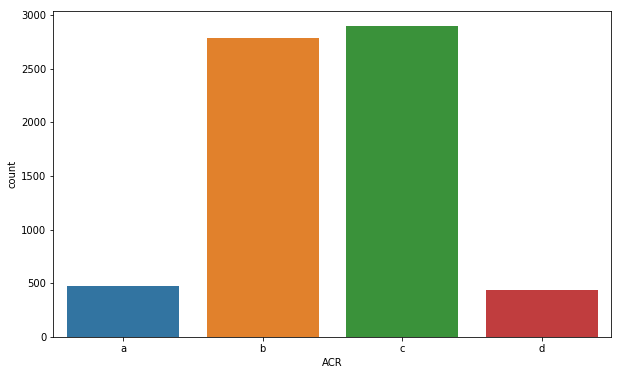

In [13]:
tipoa=data["ACR"]== 'a'
tipob=data["ACR"]== 'b'
tipoc=data["ACR"]== 'c'
tipod=data["ACR"]== 'd'
print("clase a:",tipoa.sum())
print("clase b:",tipob.sum())
print("clase c:",tipoc.sum())
print("clase d:",tipod.sum())

plt.figure(figsize=(10,6))
ax = sns.countplot(x="ACR",order=['a','b','c','d'], data=dataframe)

La característica 'ACR' es la de interés principal, partiendo de esta premisa, desribiremos las demás variables.
Dentro de las categorías tipo "b" y tipo "c" se ubican la mayoría de las imágenes.

VIEW : se han tenido en cuenta la vista con la cuál se toman las mamografías, siendo respectivamente:
    *  CC:Vista craneo caudal de la imagen
    *  MLO: Vista oblicua mediolateral. 
    *  MLOID: Vista oblicua mediolateral en pacientes con prótesis (^)
    
(^) esto debe ser revisado porque hayamos imágenes con "View" igual a "MLOID" y sin prótesis, como se muestra en la celda siguiente.

In [14]:
_test = (data["View"] == "MLOID") & (data["Dcm_23"] == "NO")
print("Imágenes con campo 'View' = MLOID y sin prótesis: ",sum(_test))

Imágenes con campo 'View' = MLOID y sin prótesis:  12


In [15]:
cc = data["View"] == "CC"
mlo = data["View"] == "MLO"
mloid= data["View"] == "MLOID"
ccsum= cc.sum()
mlosum= mlo.sum()
mloidsum= mloid.sum()
print("Vista craneo caudal de la imagen: ",ccsum)
print("Vista oblicua mediolateral: ",mlosum)
print("Vista oblicua mediolateral con prótesis : ",mloidsum)

Vista craneo caudal de la imagen:  3049
Vista oblicua mediolateral:  3304
Vista oblicua mediolateral con prótesis :  41


El tamaño de la muestra para la categoría MLOID, afectaría la distribución de los datos para la variable MLOID, se aconseja revisar dicha categoría en el momento de realizar los modelos predictivos asumiendo un fuerte desbalance en los datos.

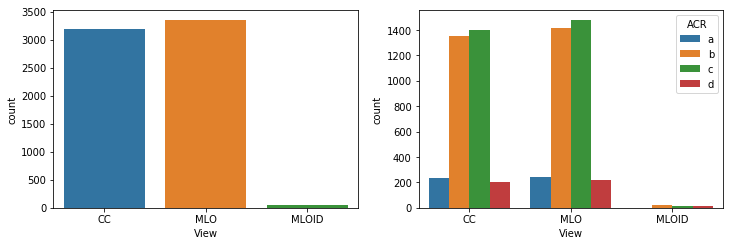

In [16]:
plt.figure(figsize=(12,8))
plt.subplot2grid((2,2),(0,0))
ax = sns.countplot(x="View", data=dataframe)
plt.subplot2grid((2,2),(0,1))
ax = sns.countplot(x="View", hue='ACR', hue_order=['a','b','c','d'], data=dataframe)

'Laterality* se registró la lateralidad de la mama en:

    * 'L' : izquieda
    * 'R' : Derecha


In [17]:
l = data["Laterality"] == "L"
r = data["Laterality"] =="R"
lsum=l.sum()
rsum=r.sum()
print("Izquierda: ",lsum)
print("Derecha: ",rsum)

Izquierda:  3200
Derecha:  3194


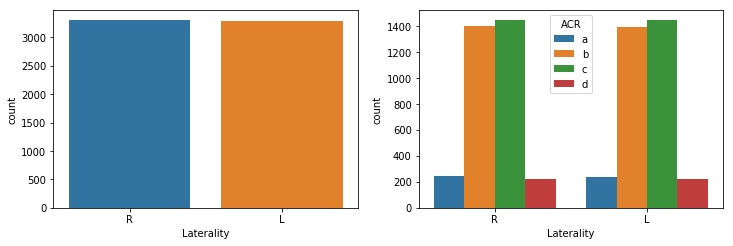

In [18]:
plt.figure(figsize=(12,8))
plt.subplot2grid((2,2),(0,0))
ax = sns.countplot(x="Laterality", data=dataframe)
plt.subplot2grid((2,2),(0,1))
ax = sns.countplot(x="Laterality", hue='ACR', hue_order=['a','b','c','d'], data=dataframe)

El número de imágenes de lateralidad izquierda y derecha deberían ser iguales pero se tienen 6 imágenes mas del lado izquierdo.

'Dcm_5'* (FilterMaterial), se distinguió en el material del filtro: 
     * 'SILVER' :Plata 
     * 'MOLYBDENUM' : Molibdeno 
     * 'RHODIUM' : Rodio



In [19]:
m=data["Dcm_5"]== 'MOLYBDENUM'
r=data["Dcm_5"]== 'RHODIUM' 
s=data["Dcm_5"]== 'SILVER'
al=data["Dcm_5"]=='ALUMINUM'
print("MOLYBDENUM:",m.sum())
print("RHODIM :",r.sum())
print("SILVER:",s.sum())
print("ALUMINUM:",al.sum())

MOLYBDENUM: 1251
RHODIM : 4244
SILVER: 899
ALUMINUM: 0


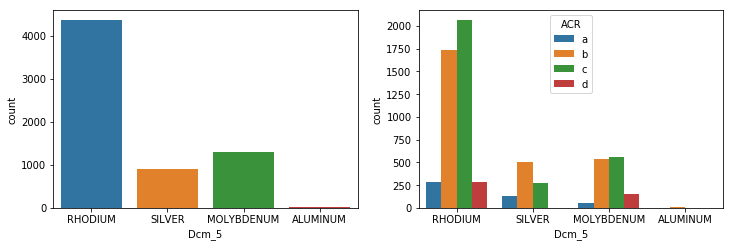

In [20]:
plt.figure(figsize=(12,8))
plt.subplot2grid((2,2),(0,0))
ax = sns.countplot(x="Dcm_5", data=dataframe)
plt.subplot2grid((2,2),(0,1))
ax = sns.countplot(x="Dcm_5", hue='ACR', hue_order=['a','b','c','d'], data=dataframe)

Si bien en la gráfica se indica el filtro de 'ALUMINIUM' no logramos ubicarlo en la tabla.

'Dcm_8'* (AnodeTargetMaterial), el material del blanco del ánodo puede estar construido de: 
    * 'MOLYBDENUM':  Molibdeno
    * 'TUNGSTEN' : Tungsteno 


In [21]:
ma=data["Dcm_8"]== 'MOLYBDENUM'
ta=data["Dcm_8"]== 'TUNGSTEN' 
print("MOLYBDENUM:",ma.sum())
print("RHODIM :",ta.sum())

MOLYBDENUM: 1561
RHODIM : 4833


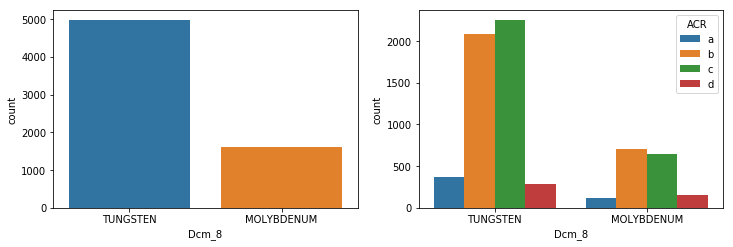

In [22]:
plt.figure(figsize=(12,8))
plt.subplot2grid((2,2),(0,0))
ax = sns.countplot(x="Dcm_8", data=dataframe)
plt.subplot2grid((2,2),(0,1))
ax = sns.countplot(x="Dcm_8", hue='ACR', hue_order=['a','b','c','d'], data=dataframe)

'Dcm_15'* (ExposureControlMode), modo de control de la exposición. 
    Existen tres posibles configuraciones: 
    * 'AUTOMATIC': Automático. 
    * 'AUTO_FILTER': Autofiltrado. 
    * 'MANUAL': Manual.



In [23]:
a=data["Dcm_15"]== 'AUTOMATIC'
f=data["Dcm_15"]== 'AUTO_FILTER'
m=data["Dcm_15"]== 'MANUAL'
print("AUTOMATIC:",a.sum())
print("AUTO_FILTER:",f.sum())
print("MANUAL:",m.sum())
  

AUTOMATIC: 4364
AUTO_FILTER: 1429
MANUAL: 601


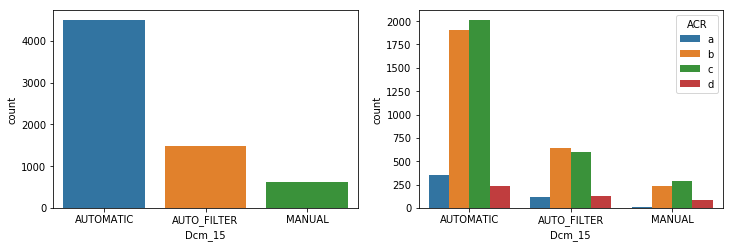

In [24]:
plt.figure(figsize=(12,8))
plt.subplot2grid((2,2),(0,0))
ax = sns.countplot(x="Dcm_15", data=dataframe)
plt.subplot2grid((2,2),(0,1))
ax = sns.countplot(x="Dcm_15", hue='ACR', hue_order=['a','b','c','d'], data=dataframe)

'Dcm_16'* (ExposureControlModeDescrip), descripción del modo de control de la exposición. 
    Existen tres posibles configuraciones: 
    * 'AutoFilter': Autofiltrado. 
    * 'MANUAL': Manual.
    * 'LORAD AUTO AEC' 
    * 'MANUAL' 
    * 'Manual' 
    



In [25]:
a=data["Dcm_16"]== 'AutoFilter'
f=data["Dcm_16"]== 'LORAD AUTO AEC'  #LORAD AUTO AEC será 'Automático'? 
m=data["Dcm_16"]== 'MANUAL'
n=data["Dcm_16"]== 'Manual'
print("Autofilter:",a.sum())
print("LORAD AUTO AEC:",f.sum())
print("MANUAL:",m.sum())
print("manual:",n.sum())


Autofilter: 4364
LORAD AUTO AEC: 1429
MANUAL: 132
manual: 469


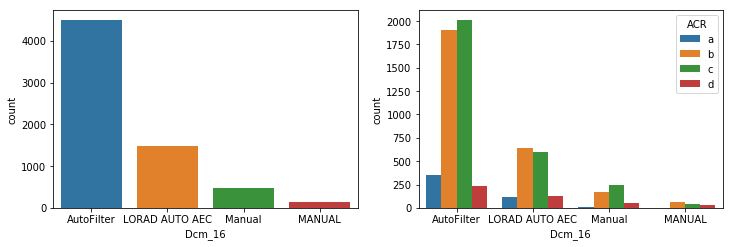

In [26]:
plt.figure(figsize=(12,8))
plt.subplot2grid((2,2),(0,0))
ax = sns.countplot(x="Dcm_16", data=dataframe)
plt.subplot2grid((2,2),(0,1))
ax = sns.countplot(x="Dcm_16", hue='ACR', hue_order=['a','b','c','d'], data=dataframe)


Deberíamos investigar si las variables denominadas "Manual" y "MANUAL" se corresponden a la misma caraterística.


'Dcm_23'* (BreastImplantPresent): presencia de implante mamario. Puede tomar dos valores:
    * 'NO' : Sí
    * 'YES': No


In [27]:
yes = data["Dcm_23"] == "YES"
no  = data["Dcm_23"] == "NO"
print("Mamografias con implantes: ",yes.sum())
print("Mamografias sin implantes: ",no.sum())

Mamografias con implantes:  683
Mamografias sin implantes:  5711


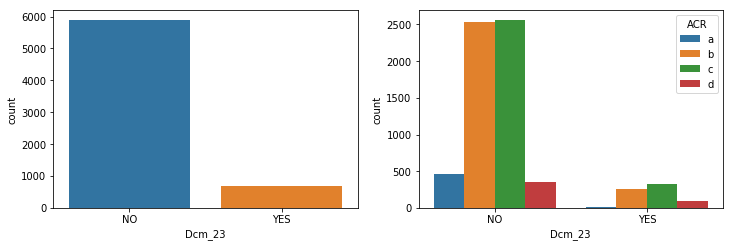

In [28]:
plt.figure(figsize=(12,8))
plt.subplot2grid((2,2),(0,0))
ax = sns.countplot(x="Dcm_23", data=dataframe)
plt.subplot2grid((2,2),(0,1))
ax = sns.countplot(x="Dcm_23", hue='ACR', hue_order=['a','b','c','d'], data=dataframe)

# Analizando variables Numéricas

Exploramos los valores de algunas medidas estadísticas tales como la media, su desviación estándar y sus valores máximos y mínimos:

In [29]:
data.describe().loc[['mean','std','min','max']]

,Age,Dcm_1,Dcm_2,Dcm_3,Dcm_4,Dcm_6,Dcm_7,Dcm_9,Dcm_10,Dcm_11,Dcm_12,Dcm_13,Dcm_14,Dcm_17,Dcm_18,Dcm_19,Dcm_20,Dcm_21,Dcm_22,Area,Promedio,Media,Desvio,Asimetria,Kurtosis,Moda,Desvio_L1,Desvio_L2,Desvio_L3,Asimetria_L1,Asimetria_L2,Asimetria_L3,promGradiente,Relacion,Relacion_L1,Relacion_L2,Relacion_L3,Relacion_L4,EP,EPBinaria,RelEntropia,Haralick_1,Haralick_2,Haralick_3,Haralick_4,Haralick_5,Haralick_6,Haralick_7,Haralick_8,Haralick_9,Haralick_10,Haralick_11,Haralick_12,Haralick_13,Haralick_14,Haralick_15,Haralick_16,Haralick_17,Haralick_18,Haralick_19,Haralick_20,Haralick_21,Haralick_22,Haralick_23,Haralick_24,Haralick_25,Haralick_26,Haralick_27,Haralick_28,Haralick_29,Haralick_30,Haralick_31,Haralick_32,Haralick_33,Haralick_34,Haralick_35,Haralick_36,Haralick_37,Haralick_38,Haralick_39,Haralick_40,Haralick_41,Haralick_42,Haralick_43,Haralick_44,Haralick_45,Haralick_46,Haralick_47,Haralick_48,Haralick_49,Haralick_50,Haralick_51,Haralick_52,DF1,DF2,DF3,DF4,DF5,DF6,DF7,DF8,DF9,DF10,DF11,DF12,DF13,DF14,DF15,DF16,DF17,DF18,DF19,DF20,DF21,DF22,DF23,DF24,DF25,DF26,DF27,DF28,DF29,DF30,DF31,DF32,DF33,DF34,DF35,DF36,DF37,DF38,DF39,DF40,DF41,DF42,DF43,DF44,DF45,DF46,DF47,DF48,DFb1,DFb2,DFb3,DFb4,DFb5,DFb6,DFb7,DFb8,DFb9,DFb10,DFb11,DFb12,DFb13,DFb14,DFb15,DFb16,DFb17,DFb18,DFb19,DFb20,DFb21,DFb22,DFb23,DFb24,DFb25,DFb26,DFb27,DFb28,DFb29,DFb30,DFb31,DFb32,DFb33,DFb34,DFb35,DFb36,DFb37,DFb38,DFb39,DFb40,DFb41,DFb42,DFb43,DFb44,DFb45,DFb46,DFb47,DFb48
mean,54.585862,29.694870,116.219112,127.289334,1011.972161,0.045117,3.000000e-01,59.160463,80.215997,690.234595,621.253519,1.055178,0.071473,387.096028,7.806425,0.017129,0.503650,2047.0,4096.0,2.724326e+06,1165.577283,1032.618940,591.243669,1.039797,1.254902,744.911480,517.357195,554.916389,534.473676,1.379845,0.886440,0.659711,21.797247,31.148492,28.481994,24.344634,31.033551,35.203845,0.768849,0.102031,0.345249,0.000005,25403.176609,0.957577,3.616466e+05,0.011742,2330.787095,1.421183e+06,11.943099,18.400899,9.938576e-07,8.278615,-0.198162,0.986634,0.000005,30332.206969,0.949600,3.616035e+05,0.010654,2330.726183,1.416082e+06,11.940811,18.514679,8.993155e-07,8.409954,-0.187007,0.983531,0.000005,25027.167795,0.958289,3.618562e+05,0.012018,2331.055790,1.422398e+06,11.943990,18.388643,1.006417e-06,8.266424,-0.199426,0.987015,0.000005,30372.259887,0.949524,3.615988e+05,0.010648,2330.725356,1.416023e+06,11.940790,18.515484,8.987152e-07,8.410952,-0.186927,0.983496,1.164743,1.465043e-02,268.644893,45.454346,0.886463,-1.056771,1.778252,0.384807,652.492447,139.995389,-0.780228,-0.230463,1.776908,0.312396,1130.486207,151.026552,-1.110652,0.194673,1.687910,0.199039,1712.194363,192.132641,-0.983962,0.325408,1.508606,0.087411,2511.080039,331.347690,1.705825,1.194508,1.717961,0.286635,1949.275987,429.204793,1.810788,1.187937,1.845249,0.599492,1524.106463,511.235346,1.638006,1.147782,1.911890,0.985093,1179.671335,585.356248,1.272676,1.059751,1.232654,0.022909,354.795188,74.480728,10.210502,0.216623,1.723954,0.283929,847.138492,217.423128,2.170905,-0.780388,1.800696,0.448911,1124.071052,312.793123,-0.120969,0.259914,1.716914,0.289231,1604.071182,372.124062,0.599545,0.307169,1.501841,0.089608,2058.665149,279.780310,14.208061,-1.573315,1.653420,0.207807,1405.168641,242.709070,9.983563,-0.419277,1.699668,0.263165,902.408020,199.547969,22.629632,1.051912,1.271789,0.029746,438.911301,424.733812,30.943661,4.054932
std,10.766752,1.752908,25.903725,54.561937,245.386301,0.008592,3.114419e-14,14.171192,26.650566,17.184273,16.532399,0.031361,32.669412,133.909239,3.829382,0.006780,0.078177,0.0,0.0,1.265073e+06,125.950909,162.845007,111.356764,0.395646,1.686301,283.524456,141.305175,138.502702,145.507885,0.553056,0.457993,0.452513,4.180652,12.835234,12.553332,13.602493,15.556086,19.369424,0.003586,0.034928,0.185098,0.000067,9416.207780,0.026946,1.344156e+05,0.003775,251.845970,5.405945e+05,0.250387,0.345419,3.394809e-07,0.318215,0.044297,0.012833,0.000067,10741.804079,0.030956,1.344233e+05,0.003299,251.841069,5.408235e

In [30]:
All_features = [x for x in data.columns if data[x].dtypes == 'float64']
Dicom_features = [x for x in data.columns if ('Dcm_' in x and data[x].dtypes == 'float64')]
Haralick_features = [x for x in data.columns if ('Haralick_' in x and data[x].dtypes == 'float64')]
DFb_features = [x for x in data.columns if ('DFb' in x and data[x].dtypes == 'float64')]
DF_features = [x for x in data.columns if ( not(x in DFb_features) and 'DF' in x and data[x].dtypes == 'float64')]
Others_features = [x for x in data.columns if ((data[x].dtypes == 'float64') and (not(x in Dicom_features) and not(x in DFb_features) and not(x in Haralick_features) and  not(x in DF_features)))]

In [31]:
print(len(All_features))

189


In [32]:
print(Others_features,end="")

['Age', 'Area', 'Promedio', 'Media', 'Desvio', 'Asimetria', 'Kurtosis', 'Moda', 'Desvio_L1', 'Desvio_L2', 'Desvio_L3', 'Asimetria_L1', 'Asimetria_L2', 'Asimetria_L3', 'promGradiente', 'Relacion', 'Relacion_L1', 'Relacion_L2', 'Relacion_L3', 'Relacion_L4', 'EP', 'EPBinaria', 'RelEntropia']

Se propone analizar la distribución de estos conjuntos de variables según la clasificación ACR 


In [33]:
#definimos algunos filtros
a_cm = data["ACR"] == "a"
b_cm = data["ACR"] == "b"
c_cm = data["ACR"] == "c"
d_cm = data["ACR"] == "d"

print('cantidad de imágenes de la base según la clase (acr)' + str('\n')+
      ' tipo a     '+ str(a_cm.sum()) + str('\n') +
      ' tipo b     '+ str(b_cm.sum()) + str('\n') +
      ' tipo c     '+ str(c_cm.sum()) + str('\n') +
      ' tipo d     '+ str(d_cm.sum()) ) 

cantidad de imágenes de la base según la clase (acr)
 tipo a     473
 tipo b     2701
 tipo c     2797
 tipo d     423


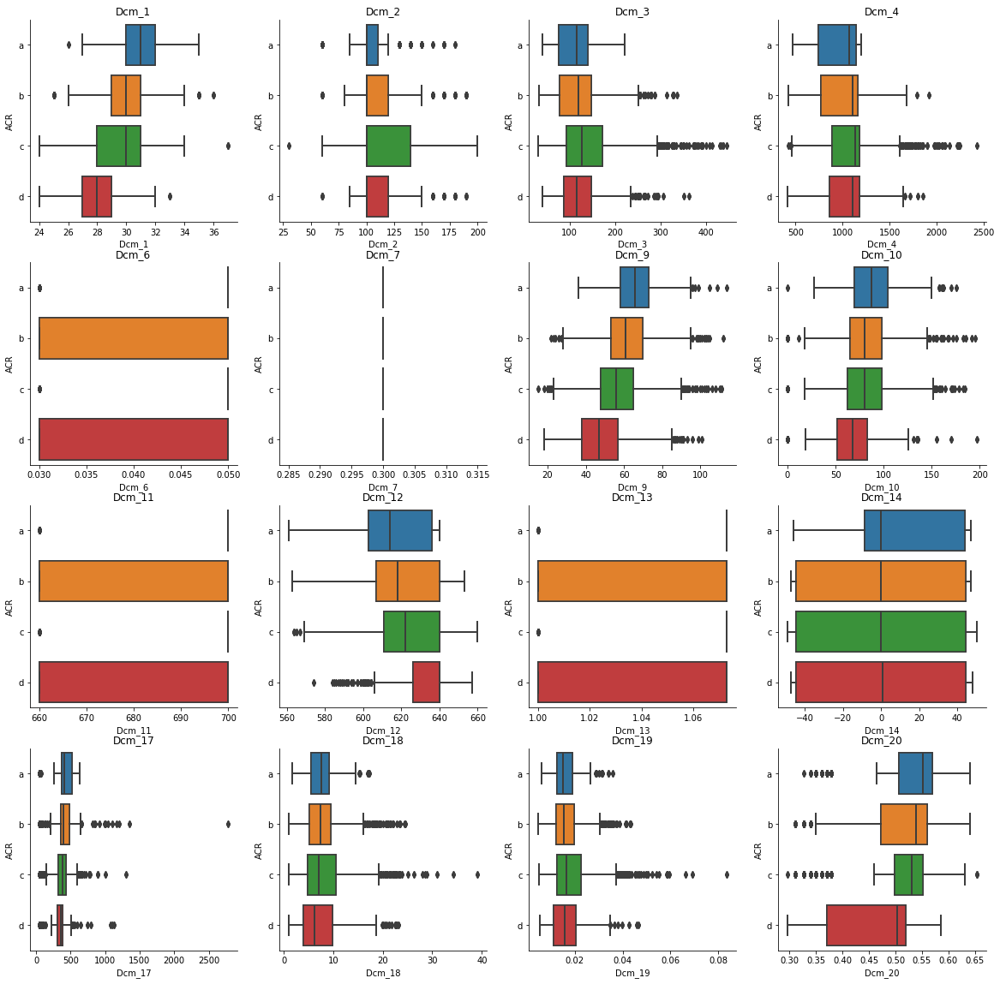

In [34]:
ntot = len(Dicom_features)
ny = 4
nx = int(ntot/ny) #+ 1

acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],Dicom_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for view,name in zip(acr_tp,Names):
        sns.boxplot(x=feature,data=data,y="ACR", order=['a','b','c','d'],ax=ax)
    ax.set_title(feature)
       
for ax in axes.flat[ntot:]:
    ax.axis("off")
sns.despine()

EXPLORACIÓN DE OUTLIERS



Dcm_1, se caracteriza por un rango intercuartílico levemente superior para el tipo de mama c que para el resto de las categorías, posicionando su medida de valor central a los valores superiores de Dcm_1.Presenta algunos pocos outliers.

Dcm_2, nuevamente se observa una mayor rango intercuartílico dentro de la categoría, tipo de mamas c, se observan outliers pero no son conderados valores extremos.

Dcm_3, Se observan outliers en todas las categorías de la variable ACR, a excepción de la variable tipo de mamas a. Aparentemente éstos valores atípicos no poseen las características de valores extremos (3 veces IRC), de todos modos necesita mayor exploración de los datos.

Dcm_4, De la misma manera,que la variable Dmc_3, la categoría tipo c presenta un volumen importante de valores atípicos si bien, no se presentan valores extremos es necesario un estudio de los mismos.

Dcm_6 ; Dcm_7; Dcm_11;Dcm_13, éstas variables no poseen valores asignados dentro de las categorías a ni c, no permiten visualizar la clasificación de mamas.

Dcm_9 y Dcm_10 presentan similares distribuciones de los valores asignados para la clasificación de mamas, con rangos intercuartílicos uniformes en dimensiones pero con distintos valores centrales. Presentan outliers en las cuatros categorías, tanto valores atípicos inferiores y valores atípicos superiores.

Dcm_12,se diferencia la presencia de outliers para la categoría tipo de mamas b, con la presencia de un valor extremo. Observar leverage.

Dcm_14, gran dispersión en la distribución de los datos de la variable para la clasificación de tipos de mamas, no se observan outliers, valores centrales similares para cada clase.

Dcm_17 valores muy concentrados alrededor del valor central, sugiere muchos outliers e inclusive presenta valores extremos de relevancia.

Dcm_18 y Dcm_19, las distribuciones de los datos observados prácticamente idénticos, con outliers en los extremos superiores de las 4 categorías, y aparentemente presencia de valores extremos.




HISTOGRAMAS

/home/marioagustin/MiniConda/envs/diplodatos/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:488: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/home/marioagustin/MiniConda/envs/diplodatos/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


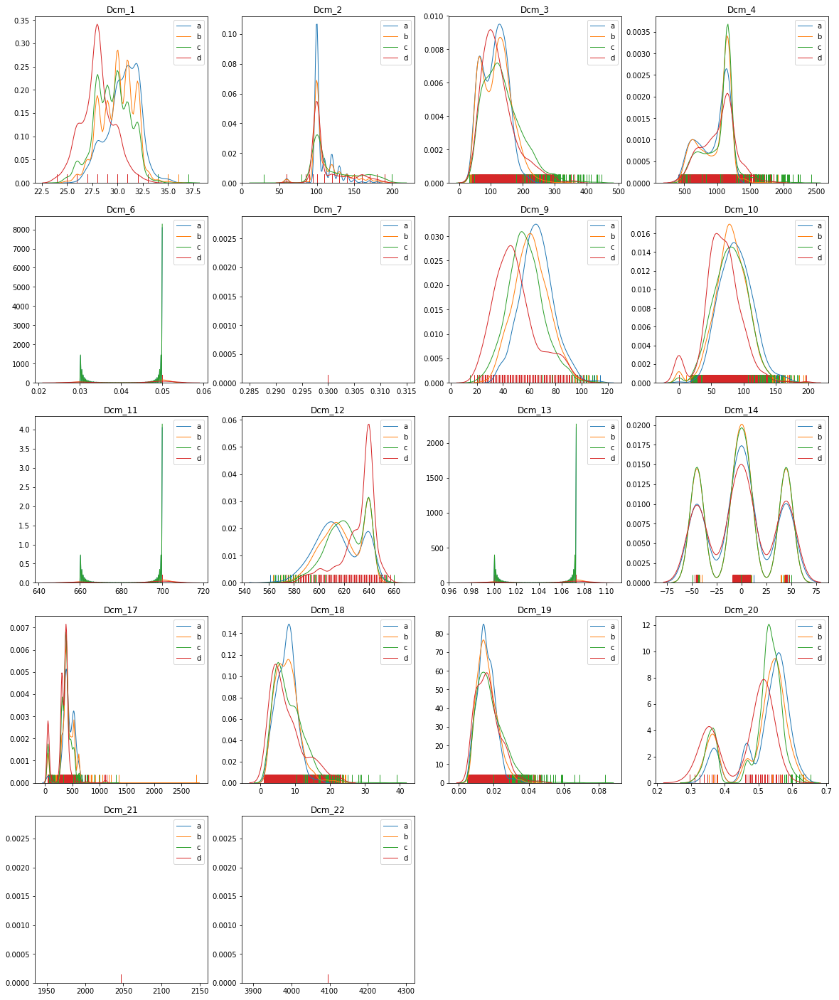

In [35]:
ntot = len(Dicom_features)
ny = 4
nx = int(ntot/ny) + 1

acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],Dicom_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for acr,name in zip(acr_tp,Names):
        sns.distplot(data[feature][acr],bins=20,ax=ax,hist=False,rug=True,kde_kws={"lw": 1,"label":name})
        #ax.hist(data[feature][acr],bins=20,density=True,alpha=0.4,label=name,range=(_min,_max))
    ax.set_xlabel("")
    ax.set_title(feature)
    ax.legend()

for ax in axes.flat[ntot:]:
    ax.axis("off")
plt.show()

En una primera vista de las columnas correspondientes a las características
DICOM (aquí indicadas como 'Dicom_features'), no aportarían a la clasificación ACR 
las columnas: DCM_6,DCM_7, DCM_11, DCM_13, DCM_21 y DCM_22, algunas de éstas variables sólo se asignan a una de las categorías de la variable ACR, y en otros casos se asignan valores a dos de las 4 tipos de mamas, podría no aportar positivamente el hecho de provocar desbalances importantes al momento de predecir los tipos de mamas.


Siendo la descripción de las mismas:     

    * Dcm_6  --> FilterThickness. 
        Espesor del filtro
    *  Dcm_7  --> FocalSpots.
        Punto focal: Tamaño nominal del punto focal en mm utilizado para adquirir la imagen.
    *  Dcm_11  --> DistanceSourceDetector
        Distancia de la fuente al detector: Distancia en mm desde la fuente hasta el centro del detector
    *  Dcm_13  --> EstimatedMagnification : Estimación de la magnificación
    *  Dcm_21  --> WindowCenter
    *  Dcm_22  --> WindowWidth  

Estas variables como así también las variables Dcm_1 y Dcm_2 presentan valores discretos, como se muestra a continuación

In [36]:
data[["Dcm_1","Dcm_2","Dcm_6","Dcm_7","Dcm_11","Dcm_13","Dcm_21","Dcm_22"]].astype("category").describe()

,Dcm_1,Dcm_2,Dcm_6,Dcm_7,Dcm_11,Dcm_13,Dcm_21,Dcm_22
count,6394.0,6394.0,6394.00,6394.0,6394.0,6394.000,6394.0,6394.0
unique,14.0,17.0,2.00,1.0,2.0,2.000,1.0,1.0
top,30.0,100.0,0.05,0.3,700.0,1.073,2047.0,4096.0
freq,1395.0,3508.0,4833.00,6394.0,4833.0,4833.000,6394.0,6394.0


In [37]:
for feature in ["Dcm_1","Dcm_2","Dcm_6","Dcm_7","Dcm_11","Dcm_13","Dcm_21","Dcm_22"]:
    print(feature,sorted(data[feature].unique()))

Dcm_1 [24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0]
Dcm_2 [30.0, 60.0, 80.0, 85.0, 90.0, 95.0, 100.0, 110.0, 120.0, 130.0, 140.0, 150.0, 160.0, 170.0, 180.0, 190.0, 200.0]
Dcm_6 [0.03, 0.05]
Dcm_7 [0.3]
Dcm_11 [660.0, 700.0]
Dcm_13 [1.0, 1.073]
Dcm_21 [2047.0]
Dcm_22 [4096.0]


In [38]:
# Las eliminamos del análisis de la base de datos:
Dicom_features.remove('Dcm_6')
Dicom_features.remove('Dcm_7')
Dicom_features.remove('Dcm_11')
Dicom_features.remove('Dcm_13')
Dicom_features.remove('Dcm_21')
Dicom_features.remove('Dcm_22')
#Se eliminan 6 columnas de DICOM

VARIABLES HARALICK

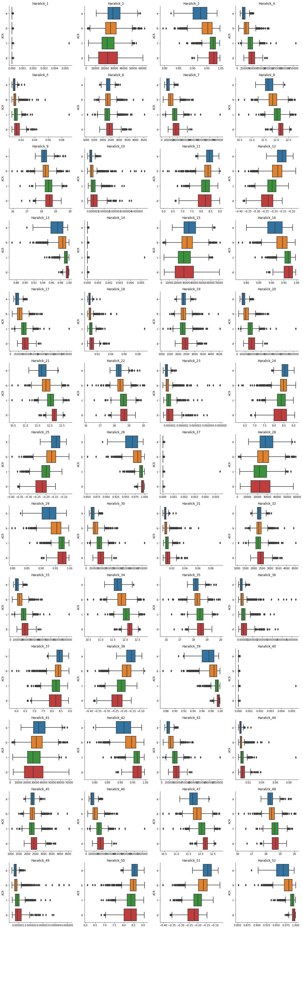

In [39]:
ntot = len(Haralick_features)
ny = 4
nx = int(ntot/ny) + 1

acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],Haralick_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for view,name in zip(acr_tp,Names):
        sns.boxplot(x=feature,data=data,y="ACR",order=['a','b','c','d'],ax=ax)
    ax.set_xlabel(" ")
    ax.set_title(feature)
       
for ax in axes.flat[ntot:]:
    ax.axis("off")
sns.despine()

Todas las variables Haralicks presentan valores outliers y valores extremos, he inclusive existen tres de ellas que parecieran estar afectadas por el leverage del valor. Es necesario una observación más detalladas de éstas variables, para determinar la eliminación de valores atípicos.

Presentan rangos intercuartílicos muy pequeños las variables Haralick; 5;10;18;23;31;36;44 con poca dispersión en los datos, valores centrales similares y presencia de outliers y valores extremos.

Dentro del conjunto de caracacterísticas las que presentan aparentemente mejor capacidad de clasificación para el tipo de mamas, serían 52;51;50;49;48;47;46;45;43;42;39;38;37;35;34;3332;30;29;28;26;25;24;22;2120;19;1716;15;1312;11;94;3;2
sin embargo, cabe aclarar que sólo se trata de una primera exploración visual. 

Bajo éstas circunstancias se sugiere realizar eliminación de outliers y sobre todo de valores extremos y luego realizar nuevamente los box-plot.


HISTOGRAMAS

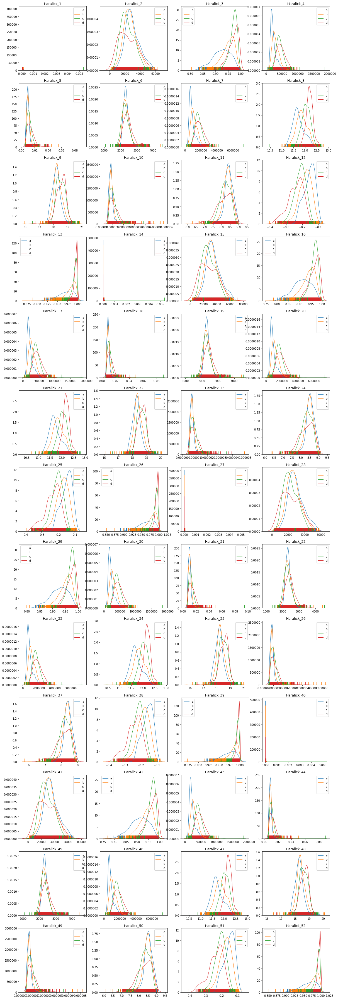

In [40]:
ntot = len(Haralick_features)
ny = 4
nx = int(ntot/ny) #+ 1

#Views = [CC,MLO,MLOID]
#Names = ["CC","MLO","MLOID"]
acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],Haralick_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for acr,name in zip(acr_tp,Names):
        sns.distplot(data[feature][acr],bins=20,ax=ax,hist=False,rug=True,kde_kws={"lw": 1,"label":name})
        #ax.hist(data[feature][acr],bins=20,density=True,alpha=0.4,label=name,range=(_min,_max))
    ax.set_xlabel("")
    ax.set_title(feature)
    ax.legend()

for ax in axes.flat[ntot:]:
    ax.axis("off")
plt.show()

 Las variables Haralick representan un conjunto de medidas de textura basadas en la matriz de  niveles de grices, 'Haralick_features', deben ser examinadas con mayor detalle para obtener conclusiones sobre la capacidad de clasificación que poseen.Sin embargo, aquellas que poseen valores únicamente para una categoría específica se eliminaron con anterioridad al exámen de inercia de valores atípicos.

In [41]:
indx = data["Haralick_1"] > 1.e-5
n_outliers = indx.sum()
print("Cantidad de Outliers a descartar: ",indx.sum(), "  %.2f " % (n_outliers/data.shape[0]),"%")
tmp = data[indx]['Dcm_23'] == "YES"
print("Con prótesis: ",tmp.sum(),"  %.2f" % (tmp.sum()/n_outliers*100),"%")
print("Con prótesis: ",(~tmp).sum(),"  %.2f" % ((~tmp).sum()/n_outliers*100),"%")

Cantidad de Outliers a descartar:  49   0.01  %
Con prótesis:  34   69.39 %
Con prótesis:  15   30.61 %


Con este corte vemos como la distribución de la variable Haralick_1 puede ser apreciada como así también las equivalentes Haralick_14, Haralick_27 y Haralick_40.

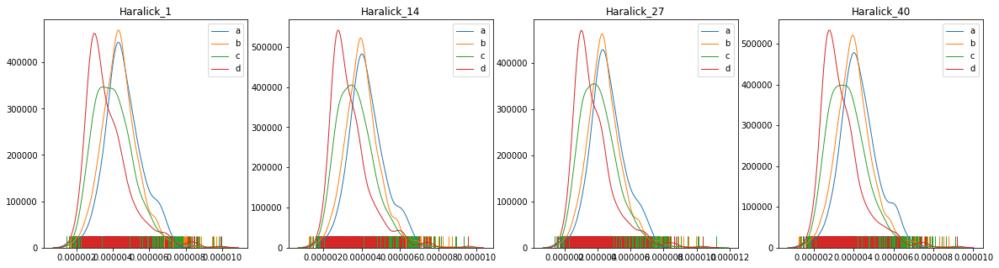

In [68]:
_H =['Haralick_1','Haralick_14','Haralick_27','Haralick_40']

ntot = len(_H)
ny = 4
nx = int(ntot/ny) #+ 1

acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],_H):
    _min = data[feature].min()
    _max = data[feature].max()
    for acr,name in zip(acr_tp,Names):
        sns.distplot(data[feature][acr],bins=20,ax=ax,hist=False,rug=True,kde_kws={"lw": 1,"label":name})
    ax.set_xlabel("")
    ax.set_title(feature)
    ax.legend()

Descartamos estos outliers

In [42]:
data.drop(data[indx].index,inplace=True)

/home/marioagustin/MiniConda/envs/diplodatos/lib/python3.6/site-packages/pandas/core/frame.py:3940: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


In [ ]:
#Ya no necesitamos hacer esto
# Eliminamos dichas columnas del análisis de la base de datos:
#Haralick_features.remove('Haralick_1')
#Haralick_features.remove('Haralick_14')
#Haralick_features.remove('Haralick_27')
#Haralick_features.remove('Haralick_40')
#Se eliminan 4 columnas de Haralick 

VARIABLES SOBRE DIMENSIÓN FRACTAL

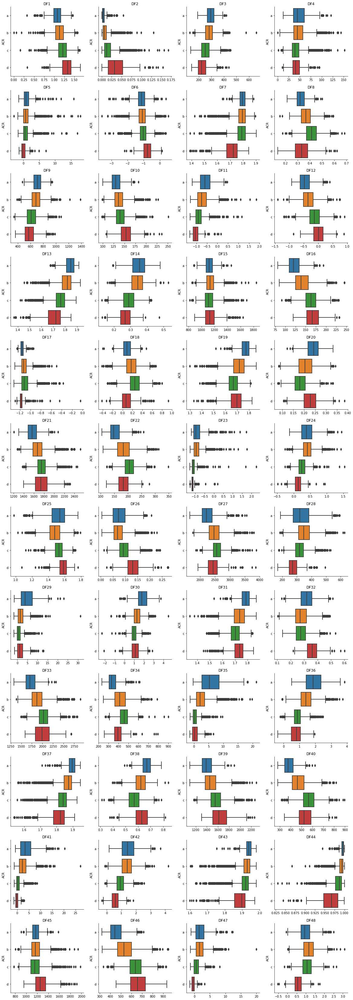

In [43]:
#DF: Características relacionadas a la dimensión fractal de la imagen. 

ntot = len(DF_features)
ny = 4
nx = int(ntot/ny) #+ 1

acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],DF_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for view,name in zip(acr_tp,Names):
        sns.boxplot(x=feature,data=data,y="ACR",order=['a','b','c','d'],ax=ax)
    ax.set_xlabel("")
    ax.set_title(feature)
       
for ax in axes.flat[ntot:]:
    ax.axis("off")
sns.despine()

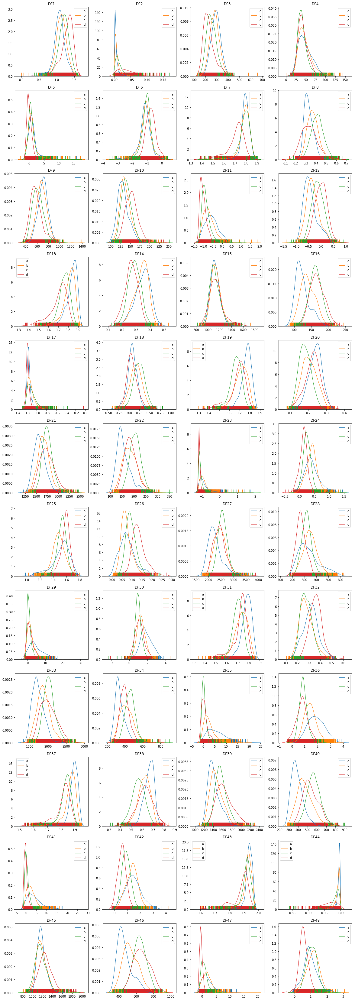

In [44]:
ntot = len(DF_features)
ny = 4
nx = int(ntot/ny) #+ 1

#Views = [CC,MLO,MLOID]
#Names = ["CC","MLO","MLOID"]
acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],DF_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for acr,name in zip(acr_tp,Names):
        sns.distplot(data[feature][acr],bins=20,ax=ax,hist=False,rug=True,kde_kws={"lw": 1,"label":name})
        #ax.hist(data[feature][acr],bins=20,density=True,alpha=0.4,label=name,range=(_min,_max))
    ax.set_xlabel("")
    ax.set_title(feature)
    ax.legend()

for ax in axes.flat[ntot:]:
    ax.axis("off")
plt.show()

Decidimos conservar todas las columnas correspondientes a las características relacionadas a la dimensión fractal de la imagen (denotada como DF en la database).

DIMENSION FRACTAL DE LOS BORDES (DFb)

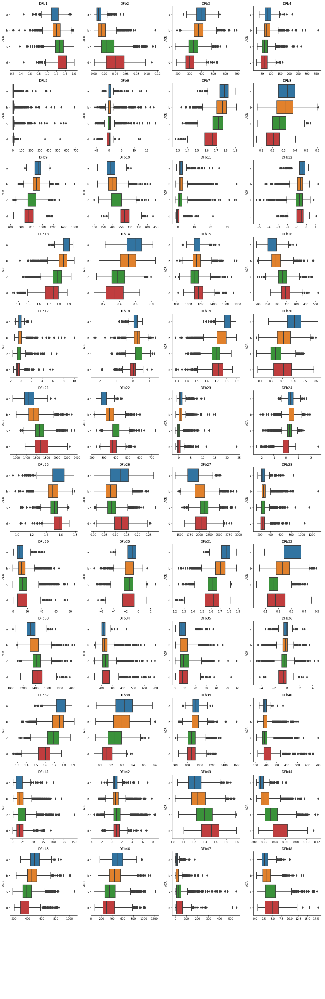

In [45]:
#DFb: Características relacionadas a la dimensi´on fractal de los bordes de la imagen.
ntot = len(DFb_features)
ny = 4
nx = int(ntot/ny) + 1

acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],DFb_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for view,name in zip(acr_tp,Names):
        sns.boxplot(x=feature,data=data,y="ACR",order=['a','b','c','d'],ax=ax)
    ax.set_xlabel("")
    ax.set_title(feature)
       
for ax in axes.flat[ntot:]:
    ax.axis("off")
sns.despine()


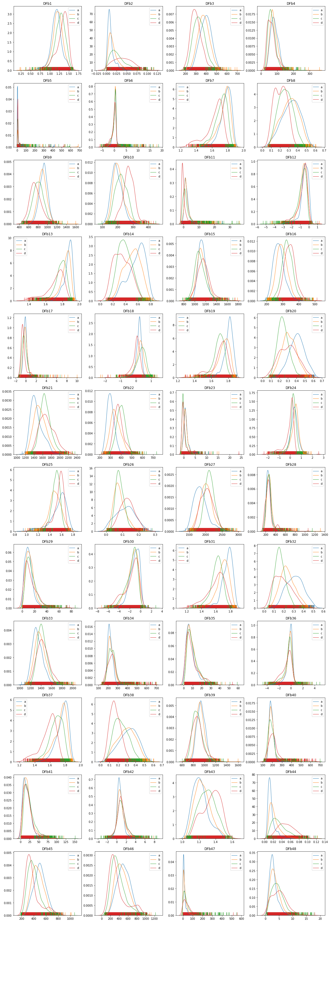

In [46]:
ntot = len(DFb_features)
ny = 4
nx = int(ntot/ny) + 1

#Views = [CC,MLO,MLOID]
#Names = ["CC","MLO","MLOID"]
acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],DFb_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for acr,name in zip(acr_tp,Names):
        sns.distplot(data[feature][acr],bins=20,ax=ax,hist=False,rug=True,kde_kws={"lw": 1,"label":name})
        #ax.hist(data[feature][acr],bins=20,density=True,alpha=0.4,label=name,range=(_min,_max))
    ax.set_xlabel("")
    ax.set_title(feature)
    ax.legend()

for ax in axes.flat[ntot:]:
    ax.axis("off")
plt.show()

Decidimos conservar todas las columnas correspondientes a las características relacionadas a la dimensión 
fractal de los bordes de la imagen (denotada como DFb en la database). 


Se observa en todas las variables DF (como también en las DFb), valores outliers y extremos, en general los valores centrales son equidistantes dentro del rango intercuartílico. Es importante analizar los valores atípicos para poder concluir sobre la selección de las características que mejor definen los tipos de mamas. 

OTRAS CARACTERÍSTICAS

In [47]:
#DFb_features.remove('DFb5') # o si?
#DFb_features.remove('DFb6') # o si?
#tienen muchos outliers, no nos decidimos si descartarlas dichas columnas

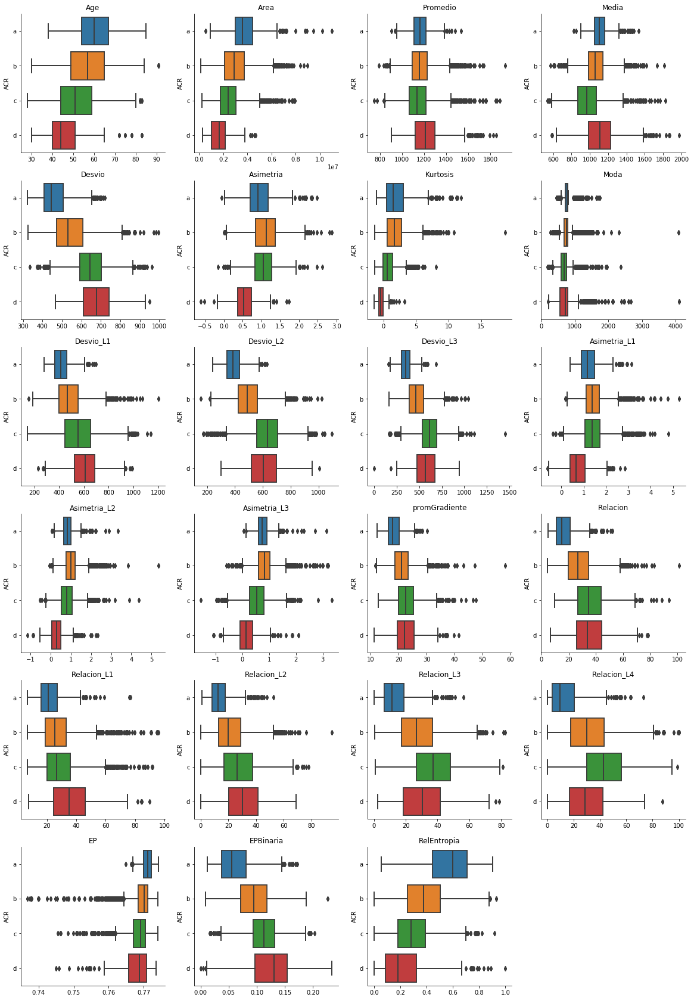

In [48]:
ntot = len(Others_features)
ny = 4
nx = int(ntot/ny) + 1

acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],Others_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for view,name in zip(acr_tp,Names):
        sns.boxplot(x=feature,data=data,y="ACR",order=['a','b','c','d'],ax=ax)
    ax.set_xlabel("")
    ax.set_title(feature)
       
for ax in axes.flat[ntot:]:
    ax.axis("off")
sns.despine()

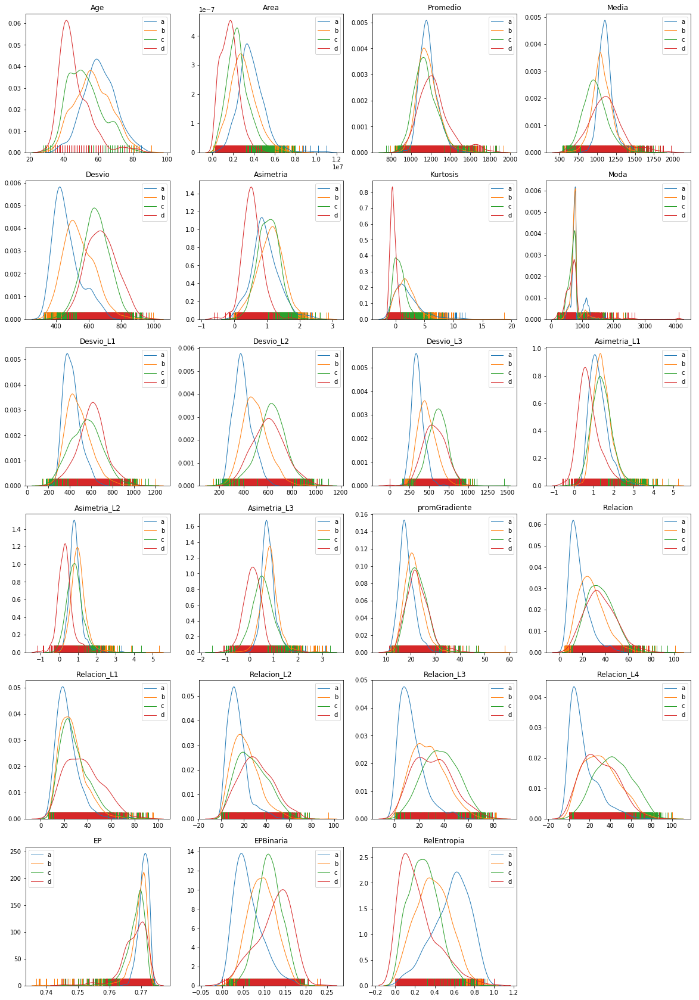

In [49]:
ntot = len(Others_features)
ny = 4
nx = int(ntot/ny) + 1

#Views = [CC,MLO,MLOID]
#Names = ["CC","MLO","MLOID"]
acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,feature in zip(axes.flat[:ntot],Others_features):
    _min = data[feature].min()
    _max = data[feature].max()
    for acr,name in zip(acr_tp,Names):
        sns.distplot(data[feature][acr],bins=20,ax=ax,hist=False,rug=True,kde_kws={"lw": 1,"label":name})
        #ax.hist(data[feature][acr],bins=20,density=True,alpha=0.4,label=name,range=(_min,_max))
    ax.set_xlabel("")
    ax.set_title(feature)
    ax.legend()

for ax in axes.flat[ntot:]:
    ax.axis("off")
plt.show()

Decidimos conservar todas las columnas correspondientes a las características restantes, denotadas como 'Others_features'

 Luego de un primer análisis exploratorio de las variables numéricas, mediante histogramas y diagramas de caja, descartamos 10 columnas (6 de características DICOM) ya que las mismas eran mono-valuadas y por lo tanto no aportarían a la clasificación. 

<font color='red'>Es necesario un análisis más exhautivo de los _outliers_ para realizar una curación más apropiada de los datos. Será parte del siguiente práctico. </font>


**2-Describir el tipo de las variables presentes en la base, analizar su distribución e identificarlas si es posible.**

Comenzaremos el análisis por conjunto de datos:

**Características DICOM**

 * Dcm_1  --> KVP 
 Kilo voltaje pico de salida del generador. 

 * Dcm_2  --> XRCurrent 
 Corriente del tubo de rayos X medida en mili Amperes.

 * Dcm_3  --> Exposure 
 Exposición: Corriente del tubo de rayos X medida en mili Amperes por segundo.

 * Dcm_4 --> ExposureTime 
Tiempo de exposición: Duración de la exposición a los rayos X medida en mili segundos.

 * Dcm_5  --> FilterMaterial 
Material del filtro: • Plata • Aluminio • Molibdeno • Rodio

* Dcm_6  --> FilterThickness 
Espesor del filtro

* Dcm_7  --> FocalSpots 
Punto focal: Tamañoo nominal del punto focal en mm utilizado para adquirir la imagen.

* Dcm_8  --> AnodeTargetMaterial
Material del blanco del ´anodo:Puede estar construido de: • Tungsteno • Molibdeno • Rodio

* Dcm_9  --> BodyPartThickness 
Espesor de la mama: El grosor promedio en mm de la parte del cuerpo examinada cuando se comprime, si se ha aplicado compresión durante la exposición.

* Dcm_10 --> CompressionForce 
Fuerza de compresión: La fuerza de compresión aplicada a la parte del cuerpo durante la exposición, medida en Newtons

* Dcm_11  --> DistanceSourceDetector 
Distancia de la fuente al detector: Distancia en mm desde la fuente hasta el centro del detector

* Dcm_12  --> DistanceSourcePatient 
Distancia de la fuente al paciente

* Dcm_13  --> EstimatedMagnification 
Estimación de la magnificación


* Dcm_14  --> PositionerPrimaryAngle 
Angulación primaria del posicionador: Distancia en mm desde la fuente hasta la mesa, el lado de apoyo más cercano al sujeto de imagen, medido a lo largo del rayo central del haz de rayos X.

* Dcm_15  --> ExposureControlMode  
Modo de control de la exposición: Existen tres posibles configuraciones: • Automático. • Autofiltrado. • Manual.

* Dcm_16  --> ExposureControlModeDescrip 
Descripción del modo de control de la exposición

* Dcm_17  --> RelativeXRExposure 
Exposición relativa a los rayos X.

* Dcm_18  --> EntranceDoseInmGy  
Dosis de entrada: El valor medio de la dosis de entrada medido en mili Gray en la superficie del paciente durante la adquisici´on de esta imagen.

* Dcm_19  --> OrganDose 
Dosis que recibe el órgano expuesto a la radiación: Valor medio de la dosis en el órgano medido en deciGray durante la adquisición de esta imagen.

* Dcm_20  --> HalfValueLayer 
Capa de valor medio: Grosor del aluminio en mm requerido para reducir la salida de rayos X en un factor de dos.

* Dcm_21  --> WindowCenter 
* Dcm_21  --> WindowWidth  

* Dcm_22  --> BreastImplantPresent 
Presencia de implante mamario: Puede tomar dos valores: • Sí. • No.






In [56]:
from scipy.stats import kde


def plot_map(x,y,color='black',label=' '):
    nbins=10
    values = np.vstack([x, y])
    k = kde.gaussian_kde(data.T)
    xi, yi = np.mgrid[x.min():x.max():nbins*1j, y.min():y.max():nbins*1j]
    zi = k(np.vstack([xi.flatten(), yi.flatten()]))
    return(contour(xi, yi, zi.reshape(xi.shape)))

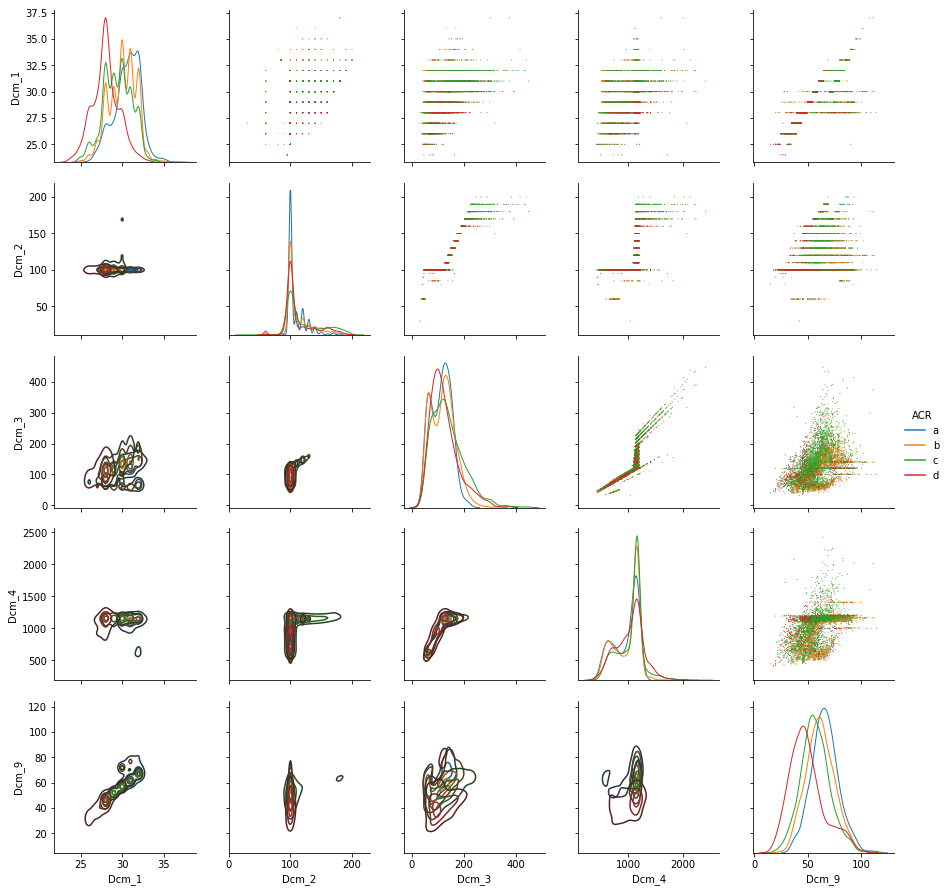

In [69]:
DC1 = Dicom_features[:5]
DC1.append('ACR')

#sns.pairplot(data[DC1],hue='ACR',hue_order=['a','b','c','d'])
#sns.despine()

g = sns.PairGrid(data[DC1],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=1, legend=False)
g.add_legend()
sns.despine()

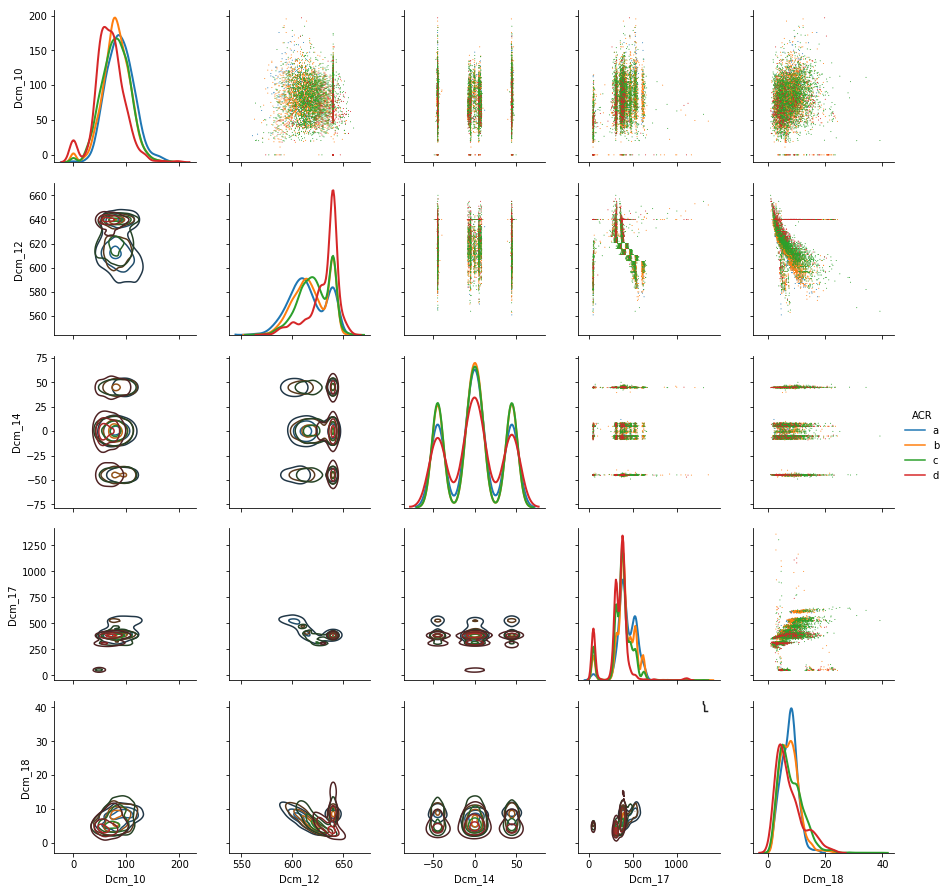

In [70]:
DC2 = Dicom_features[5:10]
DC2.append('ACR')
#sns.pairplot(data[DC2],hue='ACR',hue_order=['a','b','c','d'],markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DC2],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

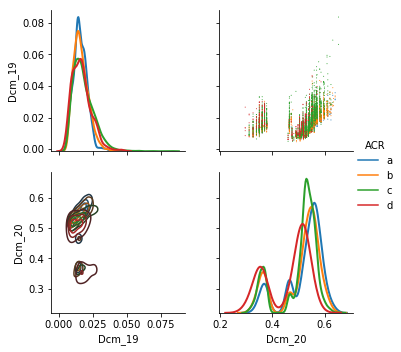

In [71]:
DC3 = Dicom_features[10:]
DC3.append('ACR')
#sns.pairplot(data[DC2],hue='ACR',hue_order=['a','b','c','d'],markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DC3],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

Del conjunto DC1, la que mejor nos permite distinguir las cuatro clases es la Dcm_9 que se refiere al 
espesor de la mama y se observa una posible correlación positiva con las demás columnas, siendo la mas 
evidente por tramos con Dcm_1 que se refiere al Kilo voltaje pico de salida del generador. 

Las variables Dcm_2, Dcm_3 y Dcm_4, a nivel exploratorio no permiten distinguir entre las 4 
categorías de 'ACR' y además se observa una correlación positiva por tramos, las cuales se refieren 
a la exposicion de rayosX. 

Del conjunto DC2, la Dcm_17 que es la correspondiente a la exposición relativa a los RX no 
permite una posible separación entre las clases. La variable Dcm_14 que se refiere al ángulo del posicionador 
y habría que ver si se observa correlación con la columna "View". 

Del conjunto DC3, la Dcm_20 que se refiere al grosor del alumnio presenta una distribución bimodal y permite distinguir las  categorías "ACR".


HARALICK FEATURES

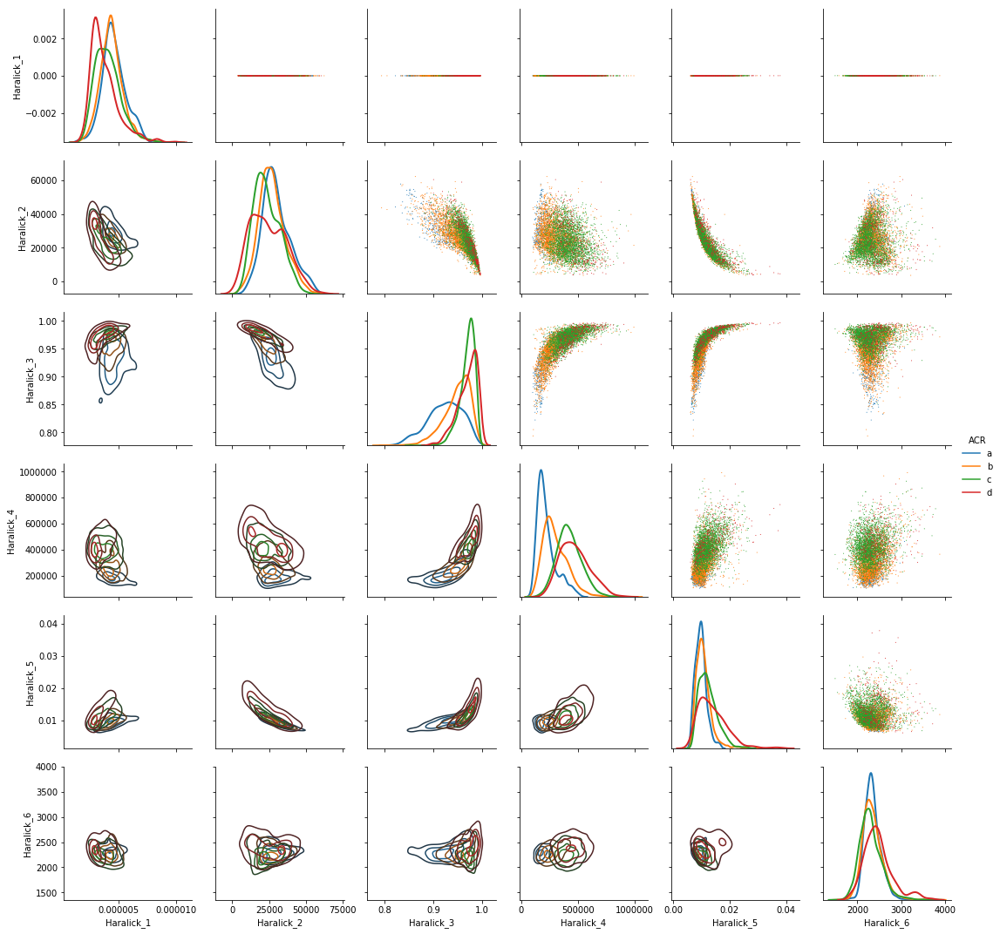

In [72]:
HR1 = Haralick_features[0:6]
HR1.append('ACR')
#sns.pairplot(data[HR1],hue='ACR',hue_order=['a','b','c','d'],markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[HR1],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

In [ ]:
#Se corresponde con HR1
#HR3 = Haralick_features[12:18]
#HR3.append('ACR')
#sns.pairplot(data[HR3],hue='ACR',hue_order=['a','b','c','d'],markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()


In [ ]:
#Se corresponde con HR1
#HR5 = Haralick_features[24:30]
#HR5.append('ACR')
#sns.pairplot(data[HR5],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

In [ ]:
#Se corresponde con HR1
#HR7 = Haralick_features[36:42]
#HR7.append('ACR')
#sns.pairplot(data[HR7],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

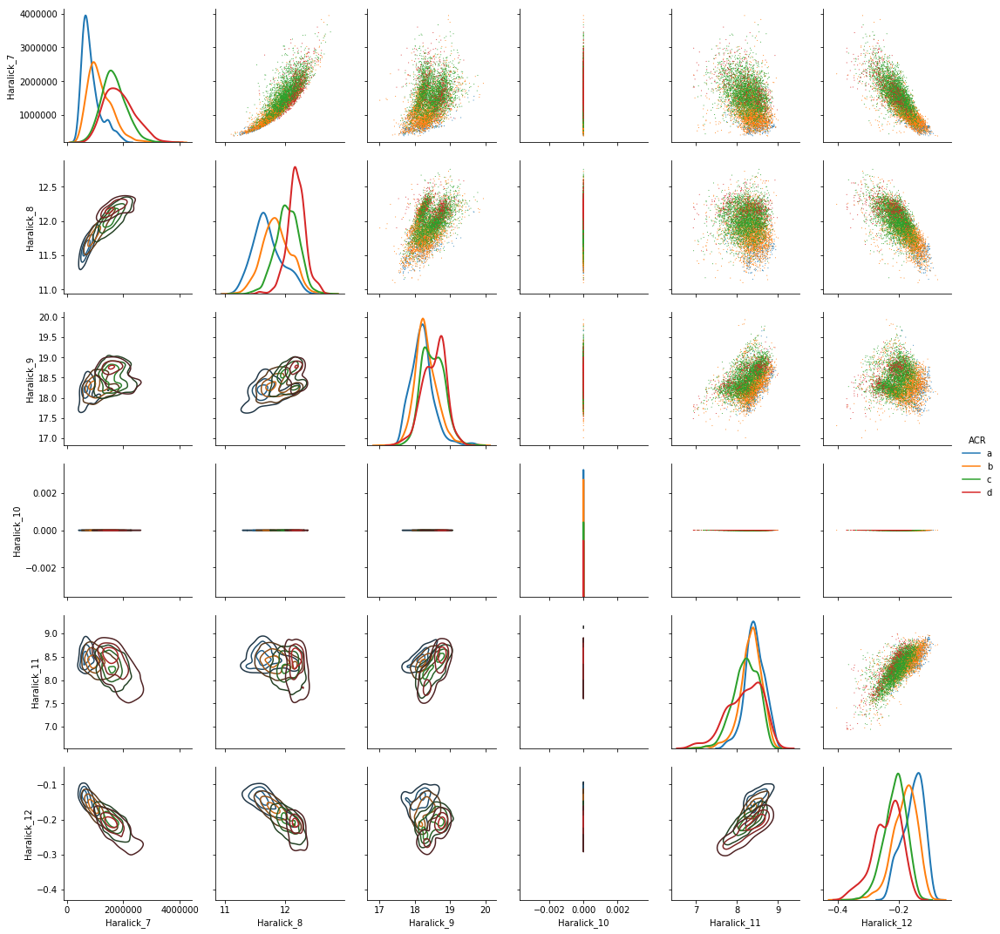

In [74]:
HR2 = Haralick_features[6:12]
HR2.append('ACR')
#sns.pairplot(data[HR2],hue='ACR', markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[HR2],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

<font color="red"> Notar que las variables Haralick_1 y Haralick_10 parece que toma valor 0, pero no es ese el caso, hay un problema de escala que deberá ser solucionado al momento de hacer la curación de los datos</font>

In [ ]:
#Se corresponde con HR2
#HR4 = Haralick_features[18:24]
#HR4.append('ACR')
#sns.pairplot(data[HR4],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

In [ ]:
#Se corresponde con HR2
#HR6 = Haralick_features[30:36]
#HR6.append('ACR')
#sns.pairplot(data[HR6],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

In [ ]:
##Se corresponde con HR2
#HR8 = Haralick_features[42:48]
#HR8.append('ACR')
#sns.pairplot(data[HR8],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

Las Haralick se corresponden con 13 magnitudes medidas desde cuatro ángulos diferentes para cada una, de las cuales se observan las mismas distribuciones para los valores observados. 

Por lo cual sólo describiremos de forma aproximada las representaciones de las primeras 13:

Presentan distribuciones simétricas las Haralik_2 y Haralik_6.
Presentan distribuciones asimétricas derechas las Haralik_11, 12 y 13.
Presenta distribuciones asimétricas izquierda las Haralik_10.

-Las columnas Haralick_1, Haralick_14, Haralik_27 y Haralick_40 fueron descartadas
ya que presentaban un solo valor, que nos indicaba un monovalor. 
Siendo su valor valor bajo un índice que indicada que todas las entradas eran similares.
    




**Dimensión Fractal (DF)**

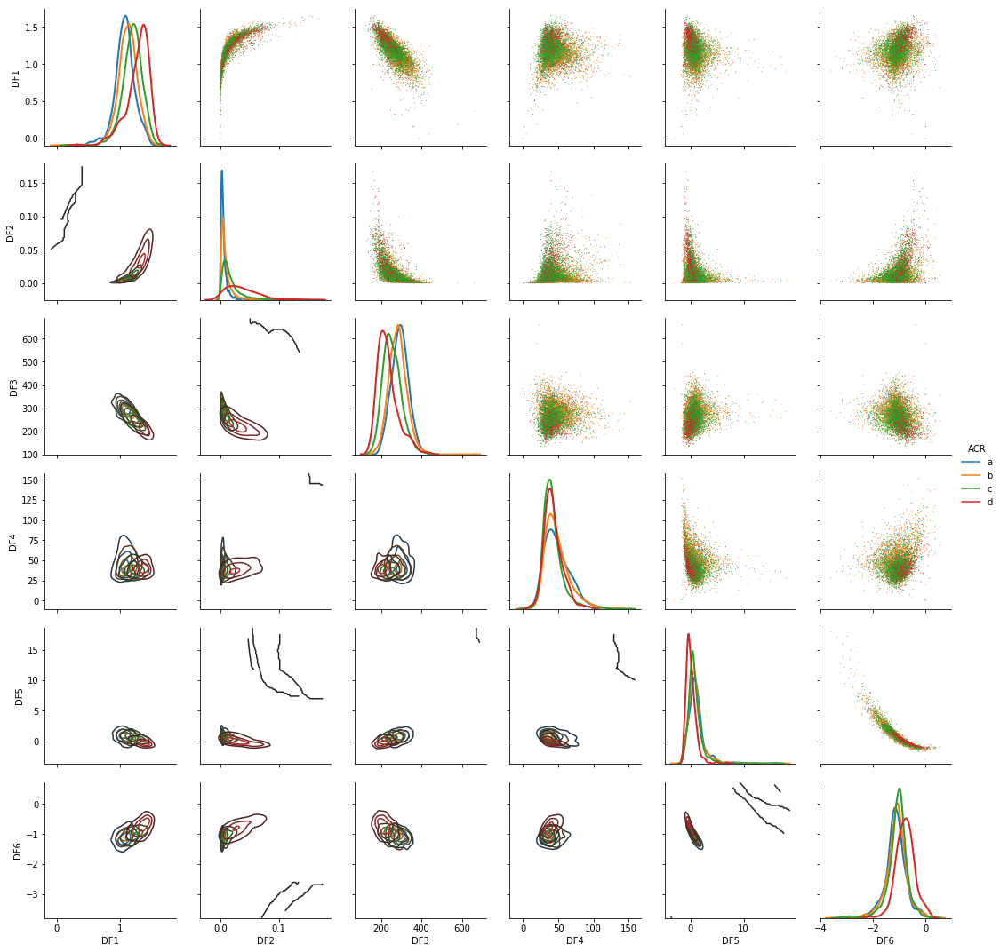

In [75]:
DF1 = DF_features[0:6]
DF1.append('ACR')
#sns.pairplot(data[DF1],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DF1],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

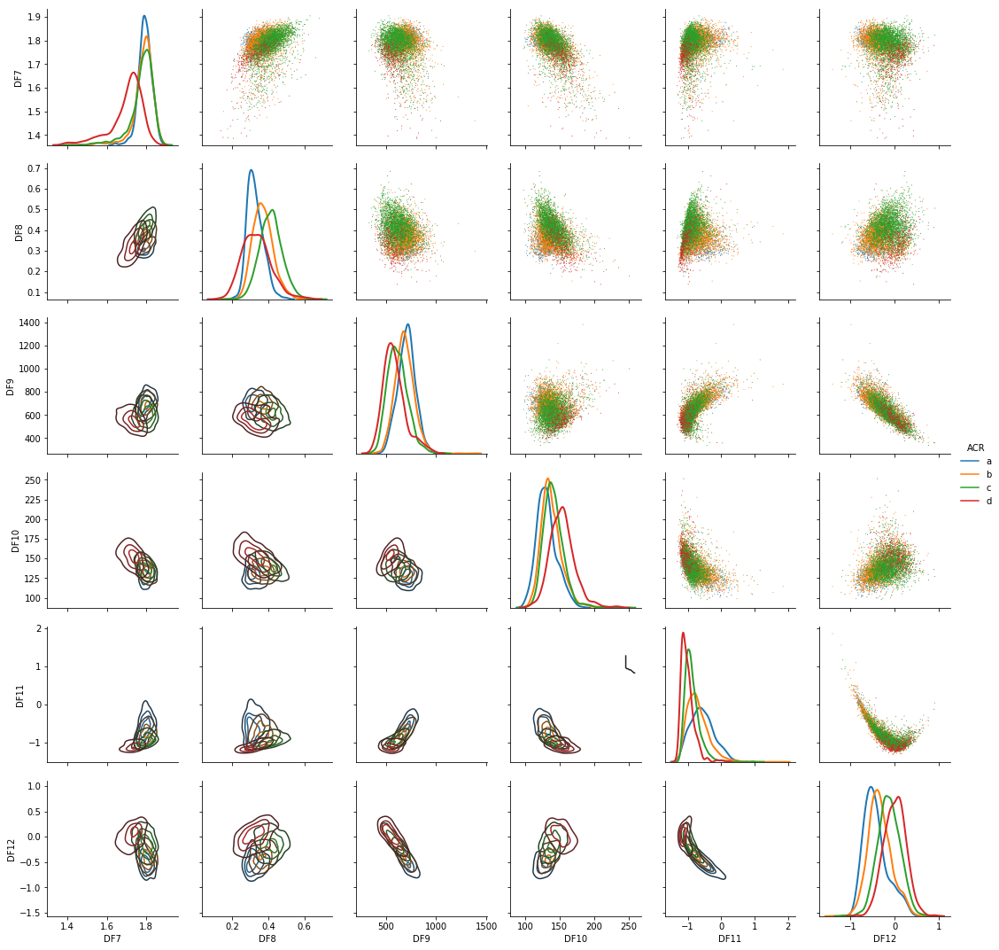

In [76]:
DF2 = DF_features[6:12]
DF2.append('ACR')
#sns.pairplot(data[DF2],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DF2],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

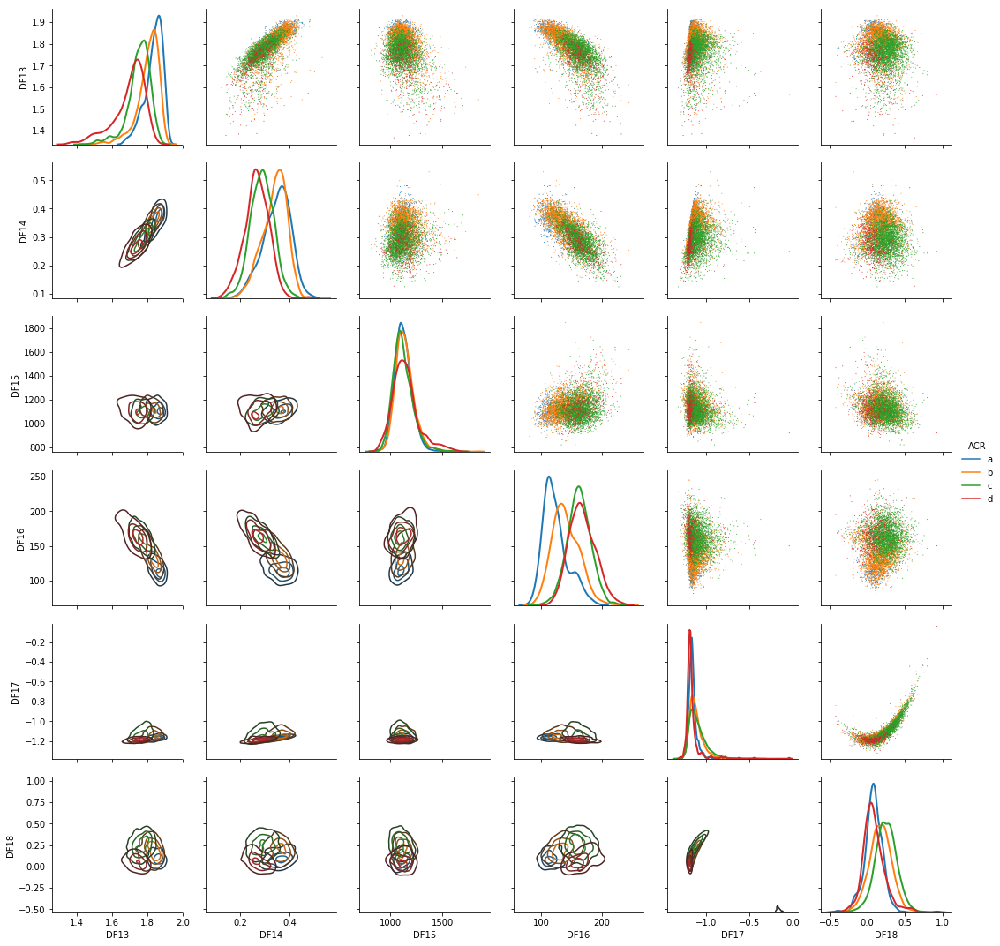

In [77]:
DF3 = DF_features[12:18]
DF3.append('ACR')
#sns.pairplot(data[DF3],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DF3],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

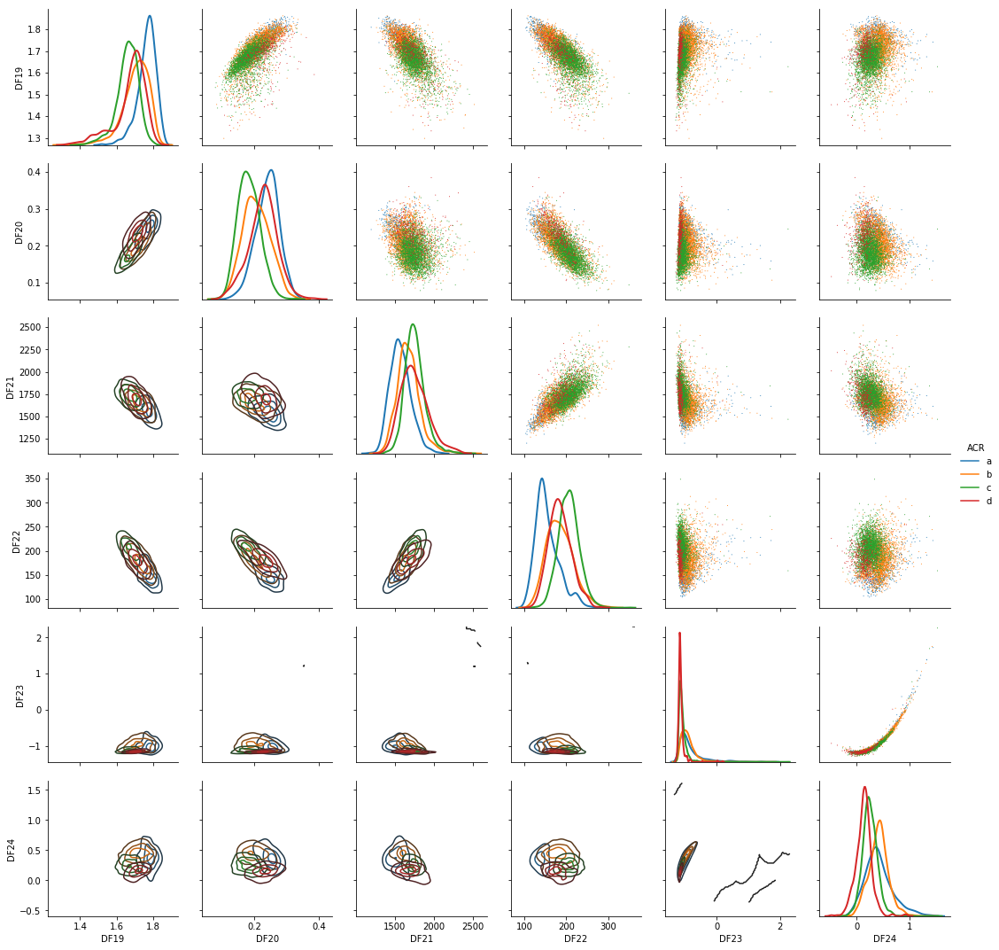

In [78]:
DF4 = DF_features[18:24]
DF4.append('ACR')
#sns.pairplot(data[DF34],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DF4],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

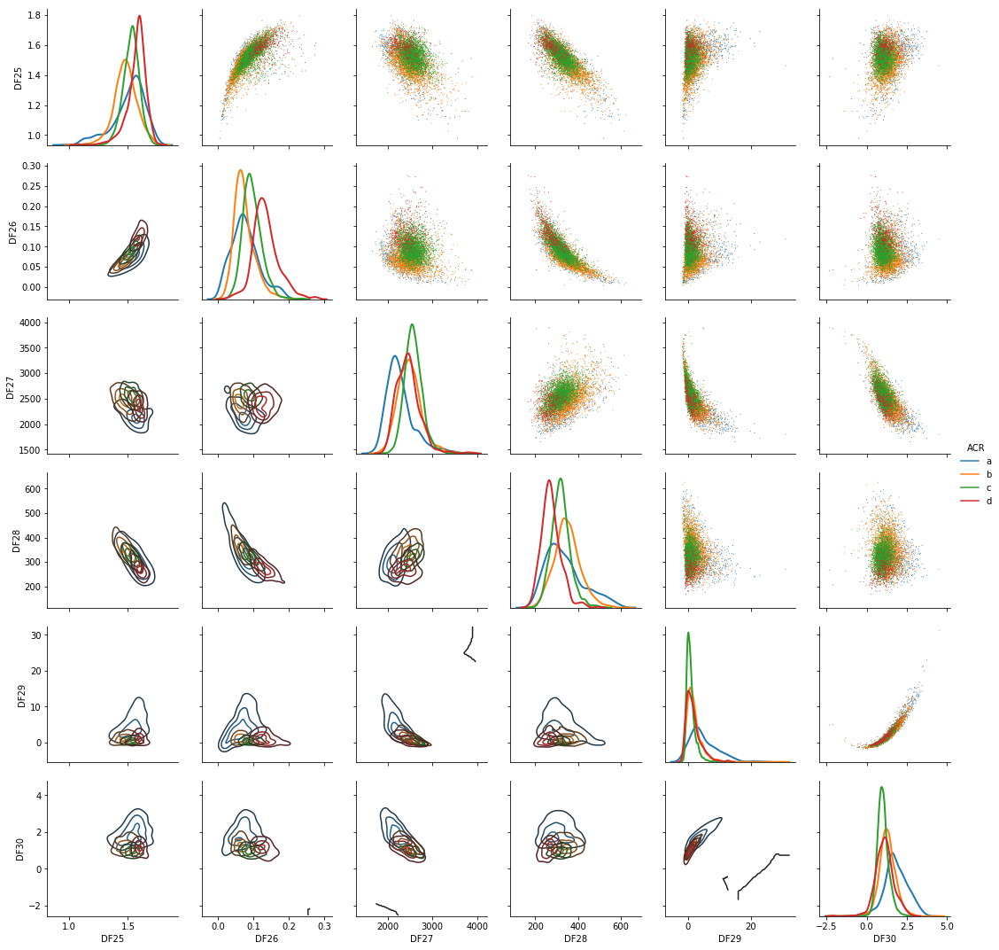

In [79]:
DF5 = DF_features[24:30]
DF5.append('ACR')
#sns.pairplot(data[DF5],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DF5],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

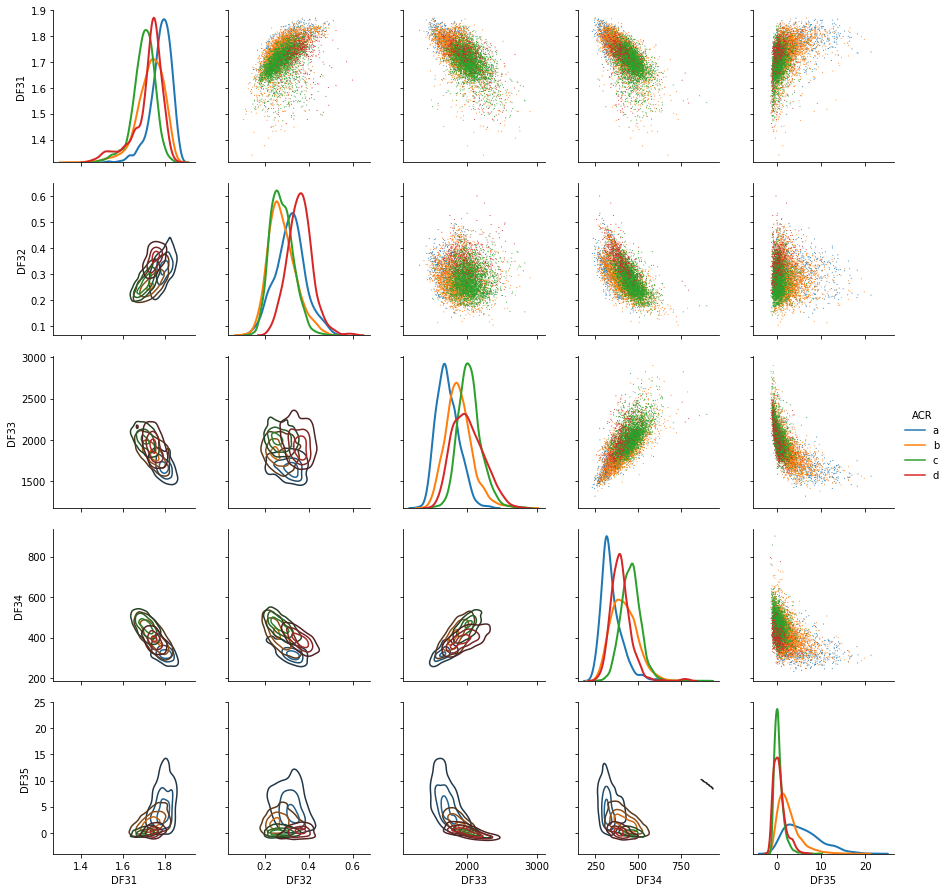

In [80]:
DF6 = DF_features[30:35]
DF6.append('ACR')
#sns.pairplot(data[DF6],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DF6],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

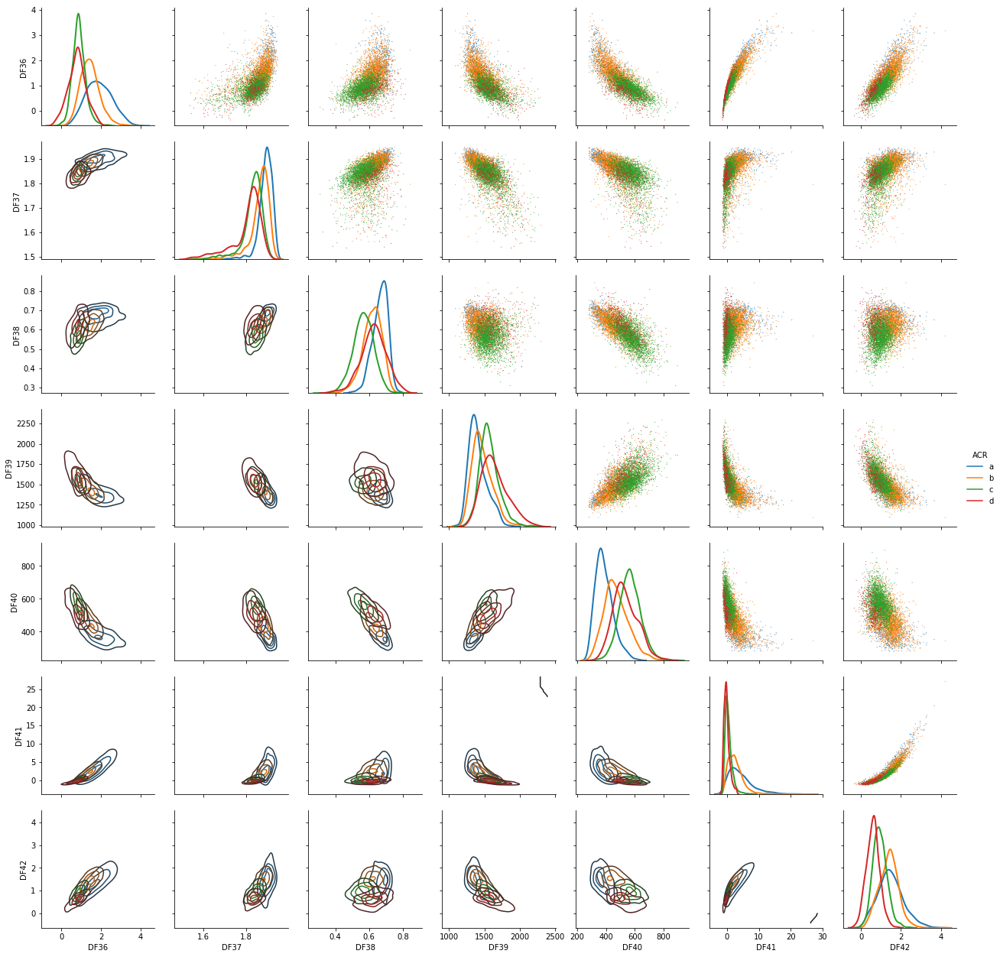

In [81]:
DF7 = DF_features[35:42]
DF7.append('ACR')
#sns.pairplot(data[DF7],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DF7],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

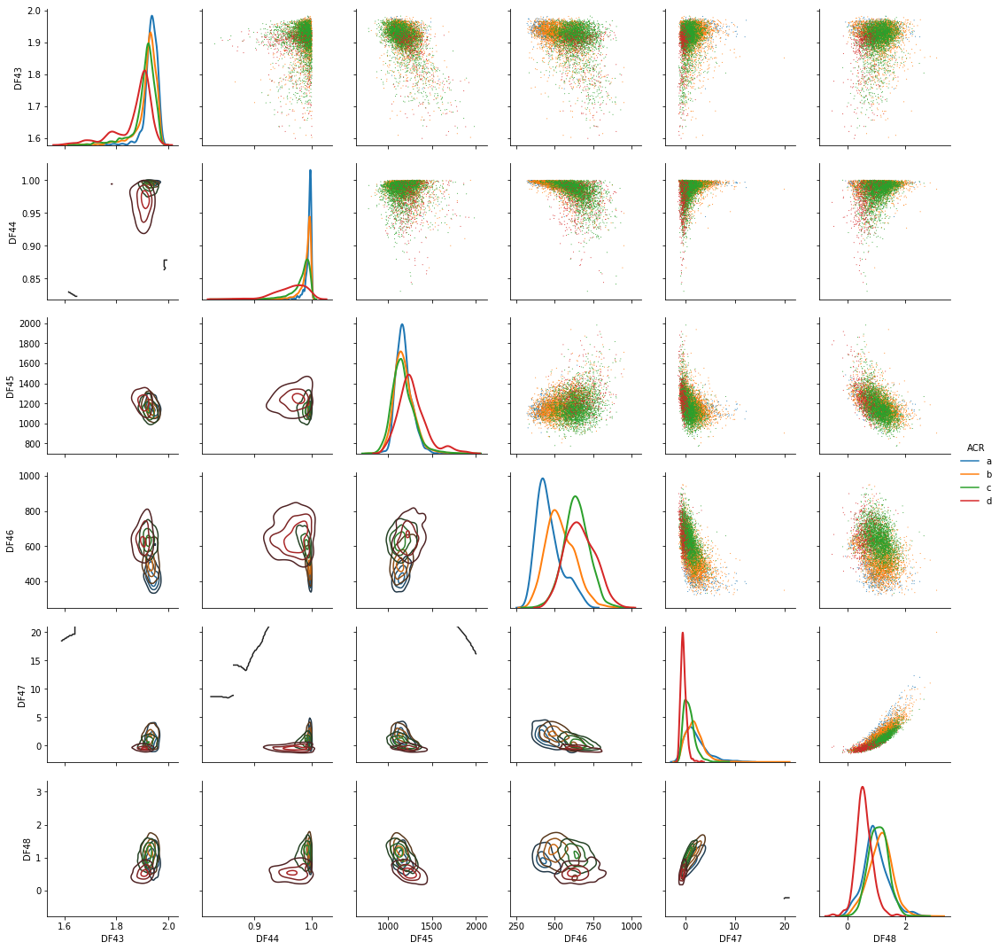

In [82]:
DF8 = DF_features[42:48]
DF8.append('ACR')
#sns.pairplot(data[DF8],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DF8],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

Las variables que presentan asimetría izquierda son: DF_2,4,5,11,23,29, 35, 41 y 47.


Las variables que presentan asimetría derecha son: DF_1, 7, 19, 25, 31, 37, 43 y 44.




**Dimensión Fractal de bordes**

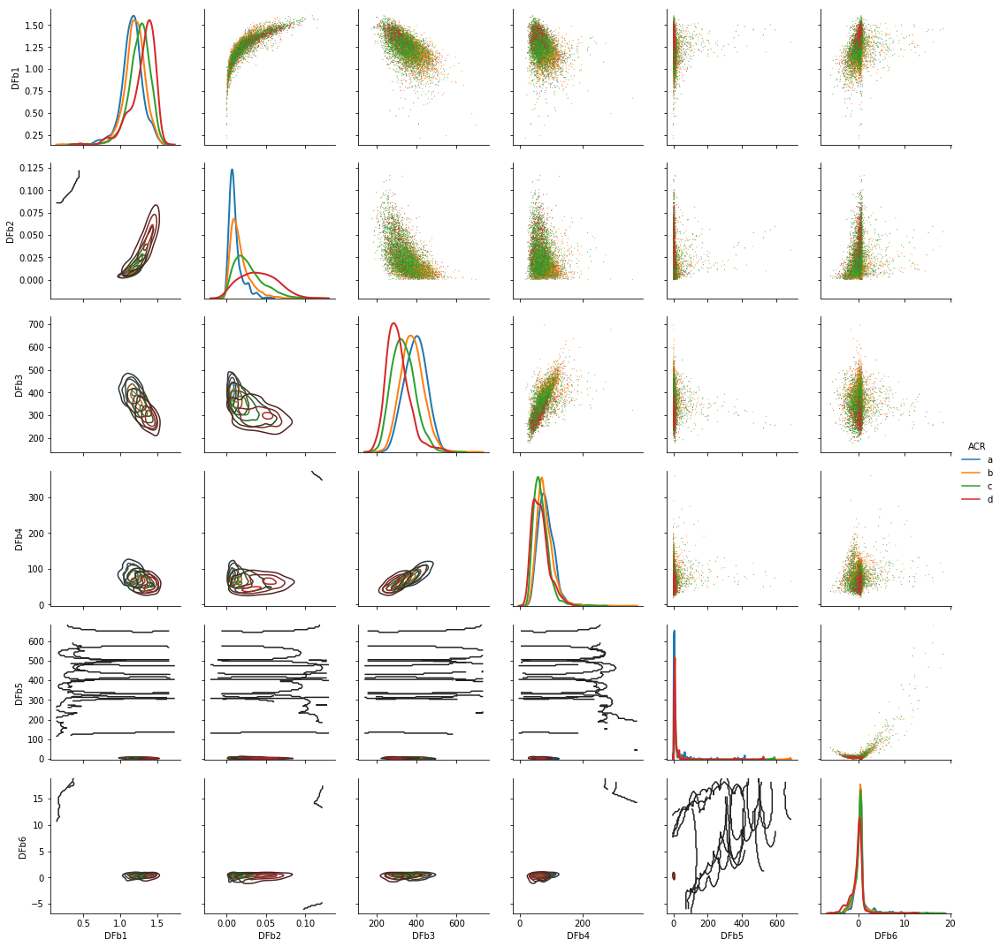

In [83]:
DFb1 = DFb_features[0:6]
DFb1.append('ACR')
#sns.pairplot(data[DFb1],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DFb1],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

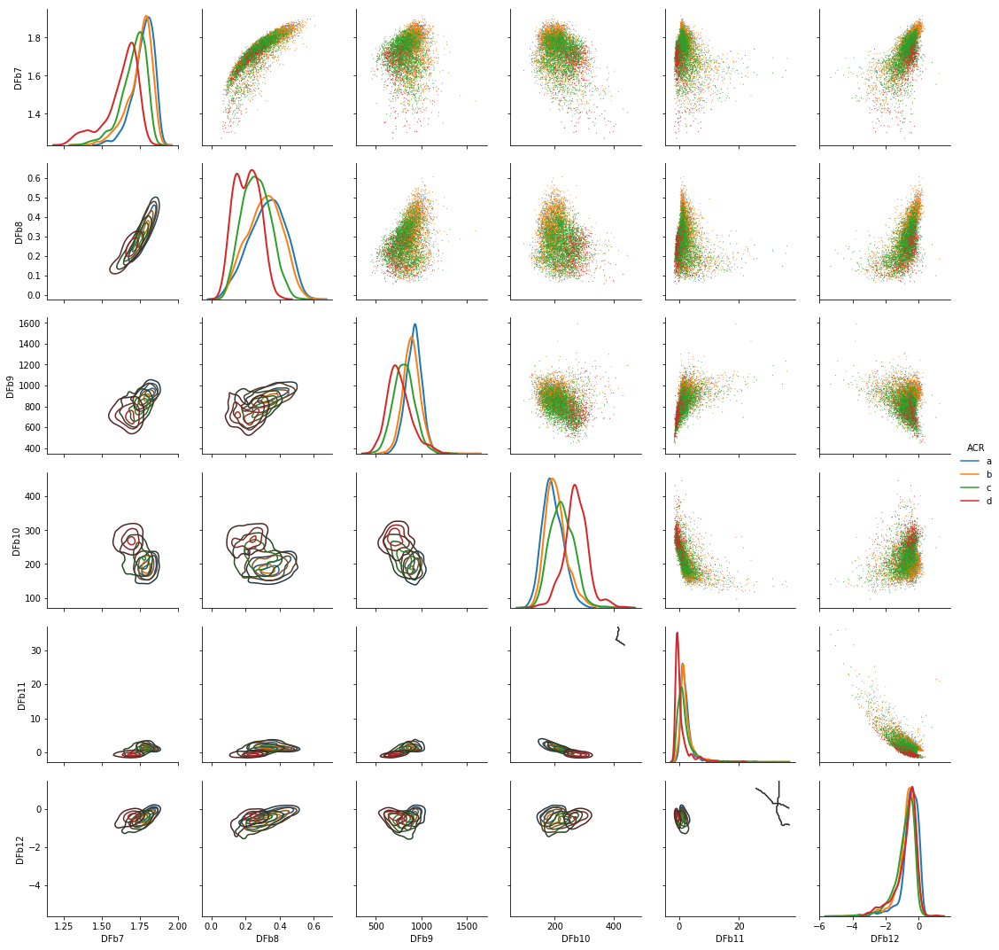

In [84]:
DFb2 = DFb_features[6:12]
DFb2.append('ACR')
#sns.pairplot(data[DFb2],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DFb2],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

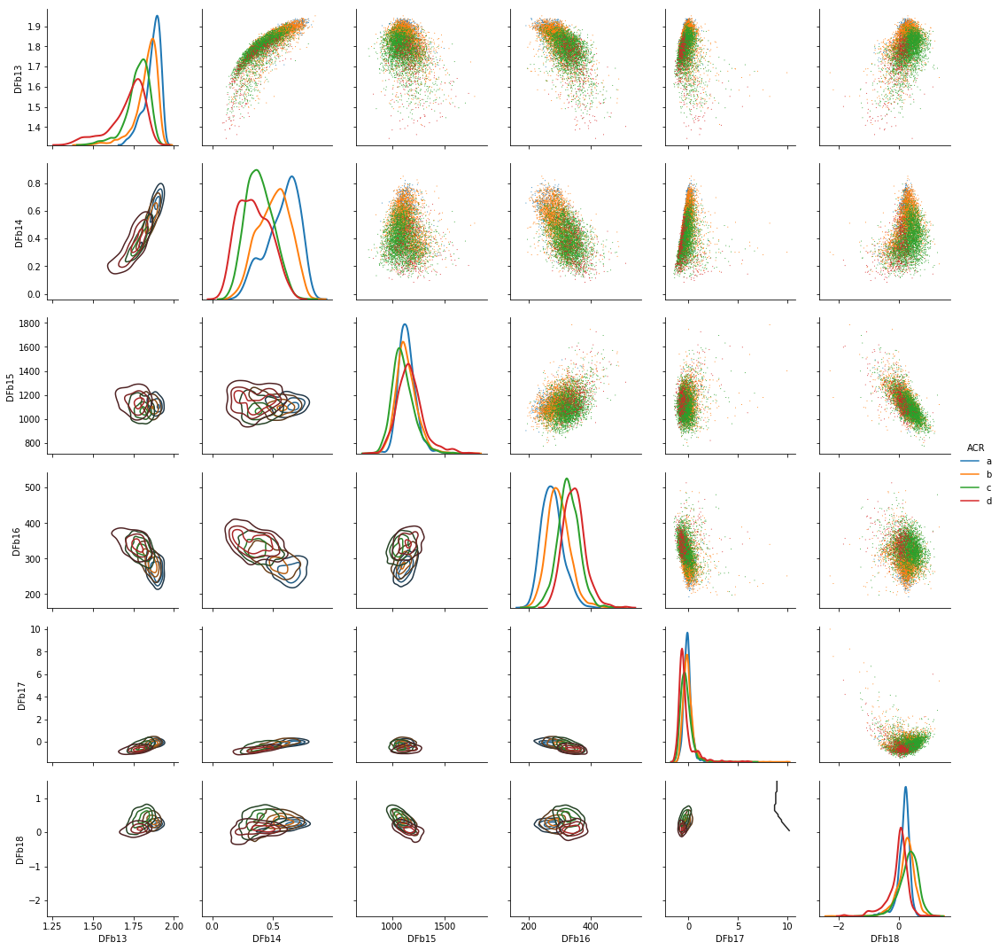

In [85]:
DFb3 = DFb_features[12:18]
DFb3.append('ACR')
#sns.pairplot(data[DFb3],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DFb3],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

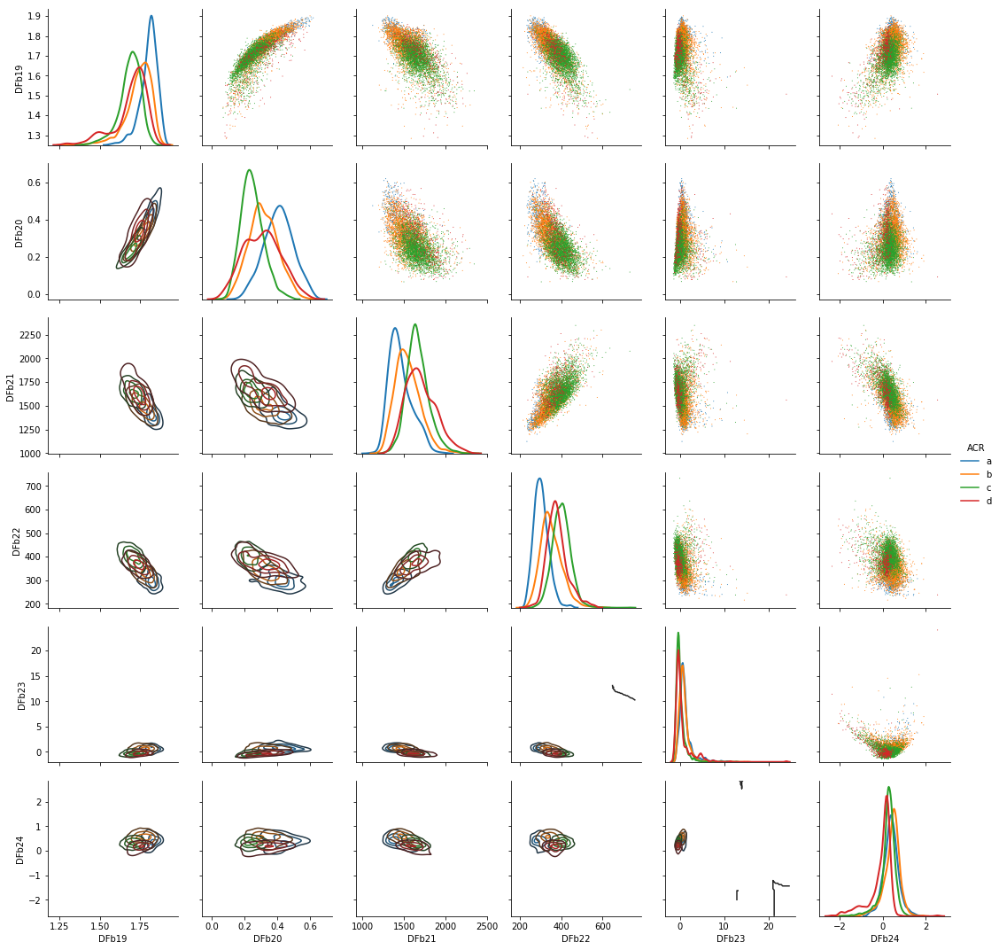

In [86]:
DFb4 = DFb_features[18:24]
DFb4.append('ACR')
#sns.pairplot(data[DFb4],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DFb4],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

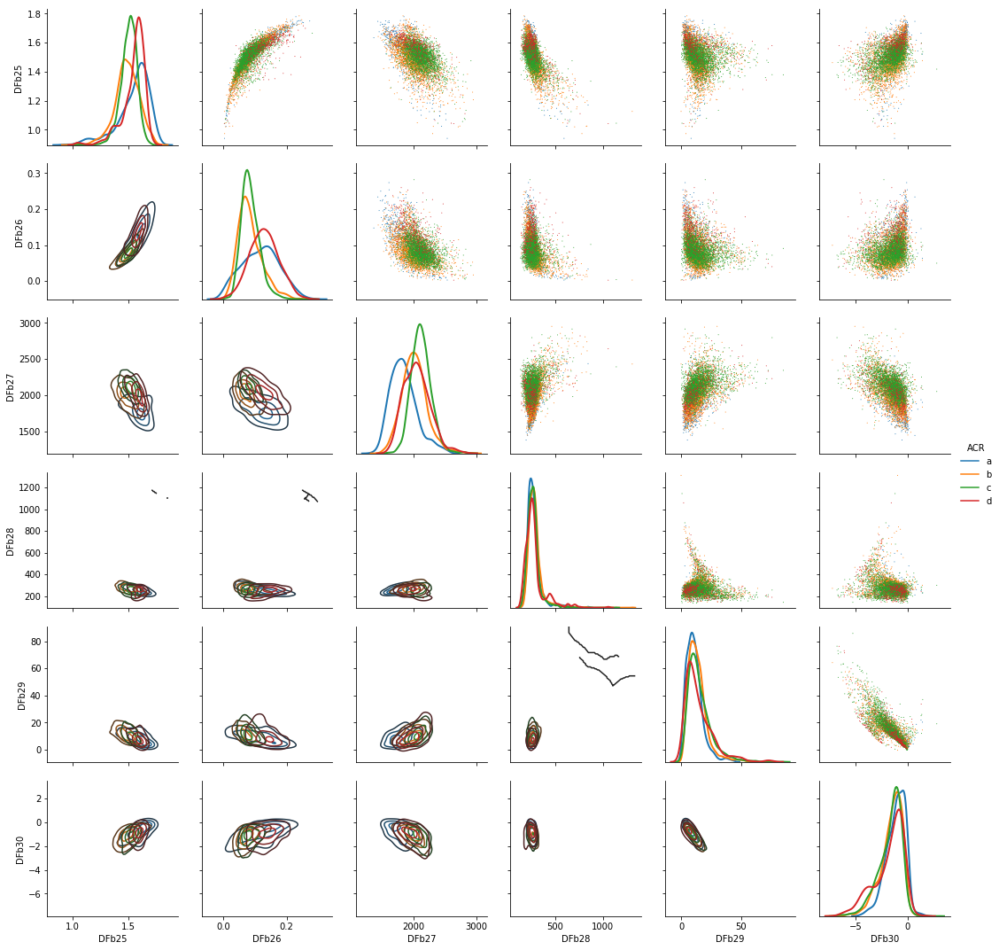

In [90]:
DFb5 = DFb_features[24:30]
DFb5.append('ACR')
#sns.pairplot(data[DFb5],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DFb5],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

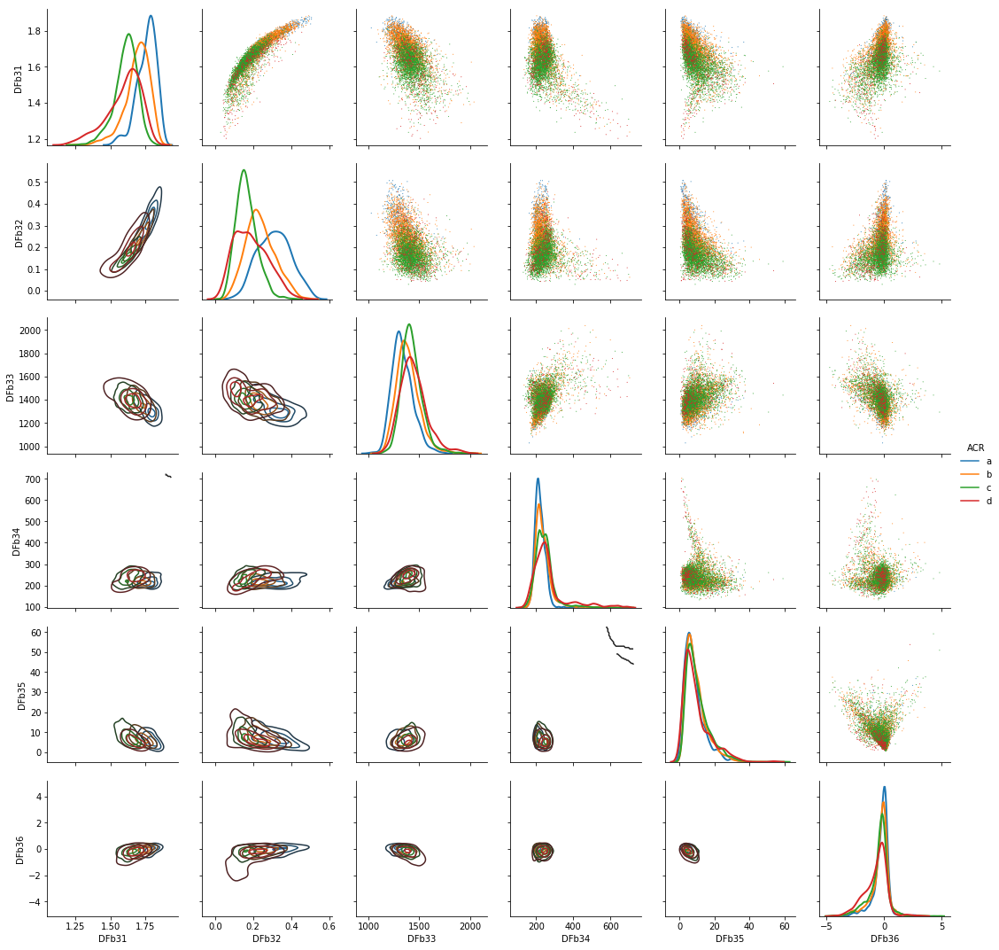

In [87]:
DFb6 = DFb_features[30:36]
DFb6.append('ACR')
#sns.pairplot(data[DFb6],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DFb6],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

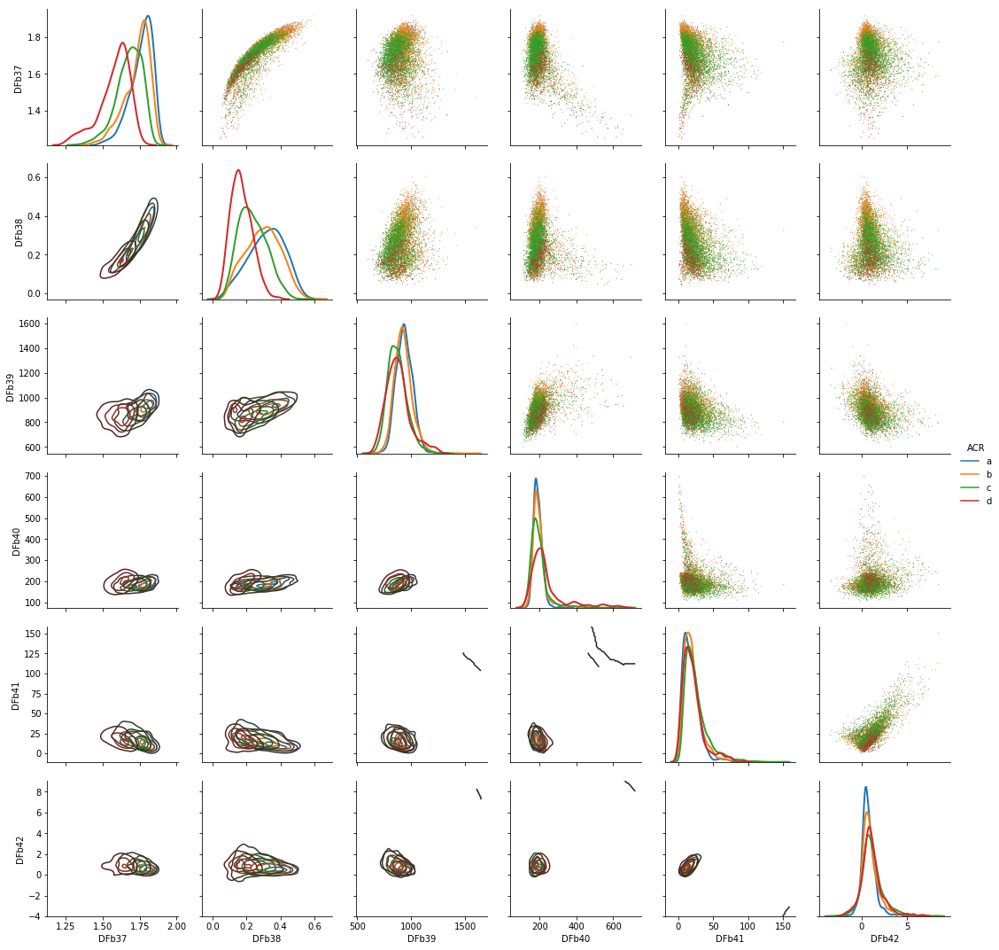

In [88]:
DFb7 = DFb_features[36:42]
DFb7.append('ACR')
#sns.pairplot(data[DFb7],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DFb7],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

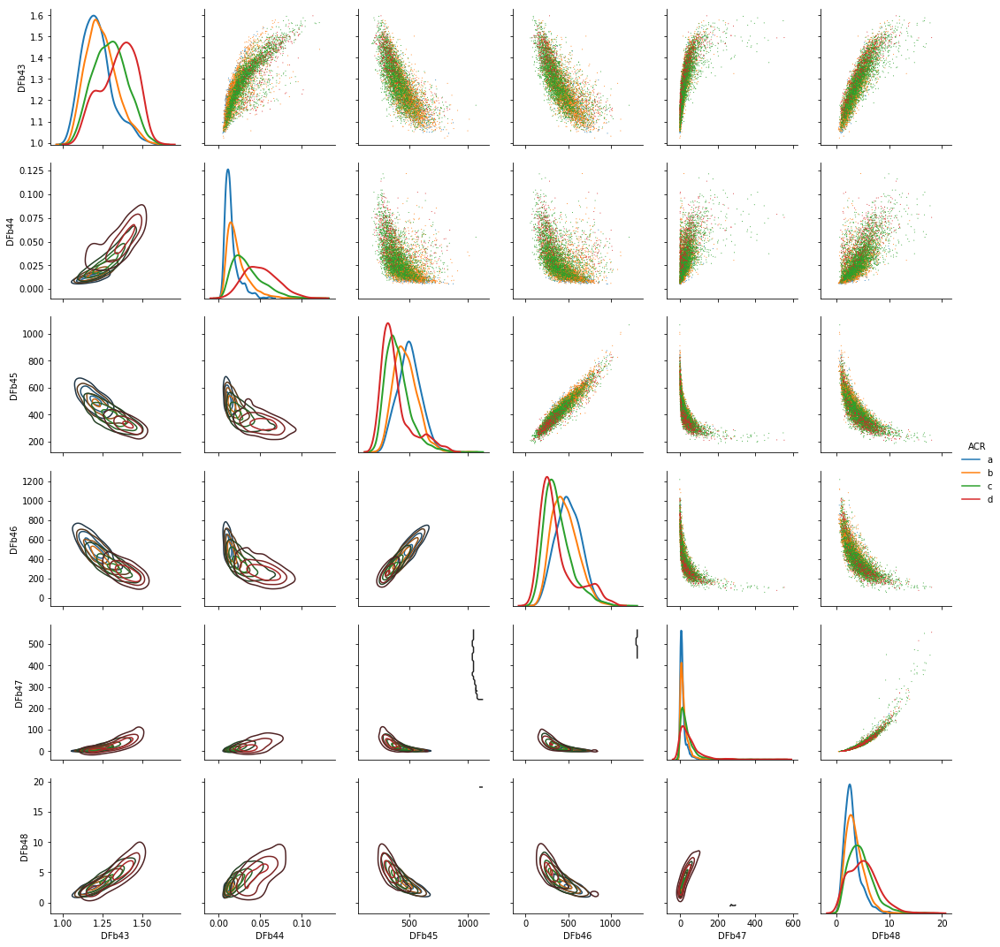

In [89]:
DFb8 = DFb_features[42:48]
DFb8.append('ACR')
#sns.pairplot(data[DFb8],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[DFb8],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

Las variables que presentan asimetría izquierda son: DFb_2,4,5,8,9,11,17,23,28,29,33,34,35,40,41,44,45,46,47.

De las dimensiones fractales, tanto las generales como las del borde (DFb) permiten distinguir entre casos en 
su mayoría. Creemos que no aportan a la separación de los casos las columnas DF_15, DF_17 y DF_23, mientras que 
de las correspondientes a las DFb creemos que son las DFb_5, DFb_6, DFb_11, DFb_12, DFb_17, DFb_23, DFb_28 
al 30,DFb_33 al DFb_36, DFb_40 al DFb_42, DFb_45 y DFb_47.     
    

**Otras caraterísticas (Others_features)**

Los datos correspondientes al *Histograma global* son: 'Promedio', 'Media', 'Mediana', 'Desviación estándar', 
    'Asimetría', 'Kurtosis' y 'Moda' .
    
Los datos correspondientes al *Histograma local* serán 'desviación estándar' y 'asimetría' de las 3 partes centrales (la del 40 %, el 70% y el 90 %, denotadas como  (L1, L2 y L3), que son las columnas
'Desvío_L1', 'Desvío_L2','Desvío_L3' y 'Asimetría_L1','Asimetría_L2' y 'Asimetría_L3'
    
    
Cuando se aplica el operador gradiente a una imagen, este devuelve otra que puede ser analizada
de la misma manera (columna 'promGradiente': una característica que representa el promedio de niveles de grises de la imagen gradiente).


Por otro lado luego de visualizar las imágenes umbralizadas, se observó que si se las divide en
porciones como en el análisis anterior y se calculan las relaciones entre píxeles blancos y totales de esa región particular, se obtendrán valores que pueden resultar significativos para la clasificación
(Relación 20/40/70/90  -> Relación L_1/L2_/L_3/L_4).

Entropía de permutaciones (EP) (la calcularon por [31?] ) Luego de aplicar este algoritmo a varias imágenes se ha notado que no hay mucha variaci´on en los valores obtenidos según sea la clase de mamografía. Sin embargo, de este análisis surgió la idea de calcular la entropía de permutaciones a la imagen que resulta de aplicar el gradiente (asumo EP) y umbralización (asumimos EPbinaria).

También  se analizó la relación entre la cantidad de celdas en las cuales su entropía resultó igual a cero y la cantidad de celdas totales analizadas (Asumimos RelEntropia)
    


En la característica 'Age' se distinguen bien las clases, siendo evidente que la clasificación 'd' es 
para mujeres mas jóvenes, mientras que las mamas tipo 'a' son de mujeres mayores. 
Para el área, se encuentra el mismo comportamiento pero con menor dispersión.
El promedio no permite una clara clasificación.
En la media estimada, los valores medias mas elevados se relacionan para 'b' y 'a'.
El Desvío permite una clasificación, siendo las mamas tipo 'a' las que presentan mayor frecuencia.
Para la Asimetría y Kurtosis, se observa un comportamiento análogo a este último descripto pero en las tipo 'd'.
Todas las clases tienen una moda similar, por lo cual no permite una clara clasificación. 

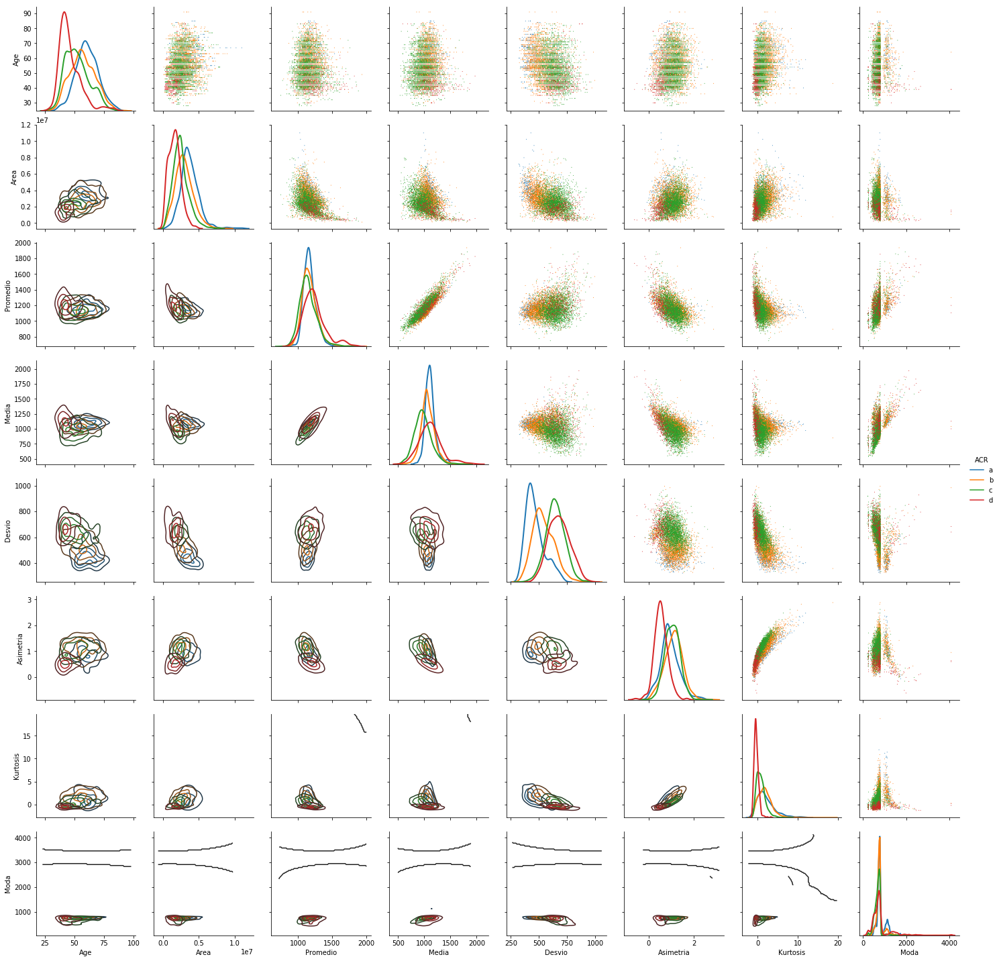

In [91]:
OF1 = Others_features[0:8]
OF1.append('ACR')
#sns.pairplot(data[OF1],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[OF1],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

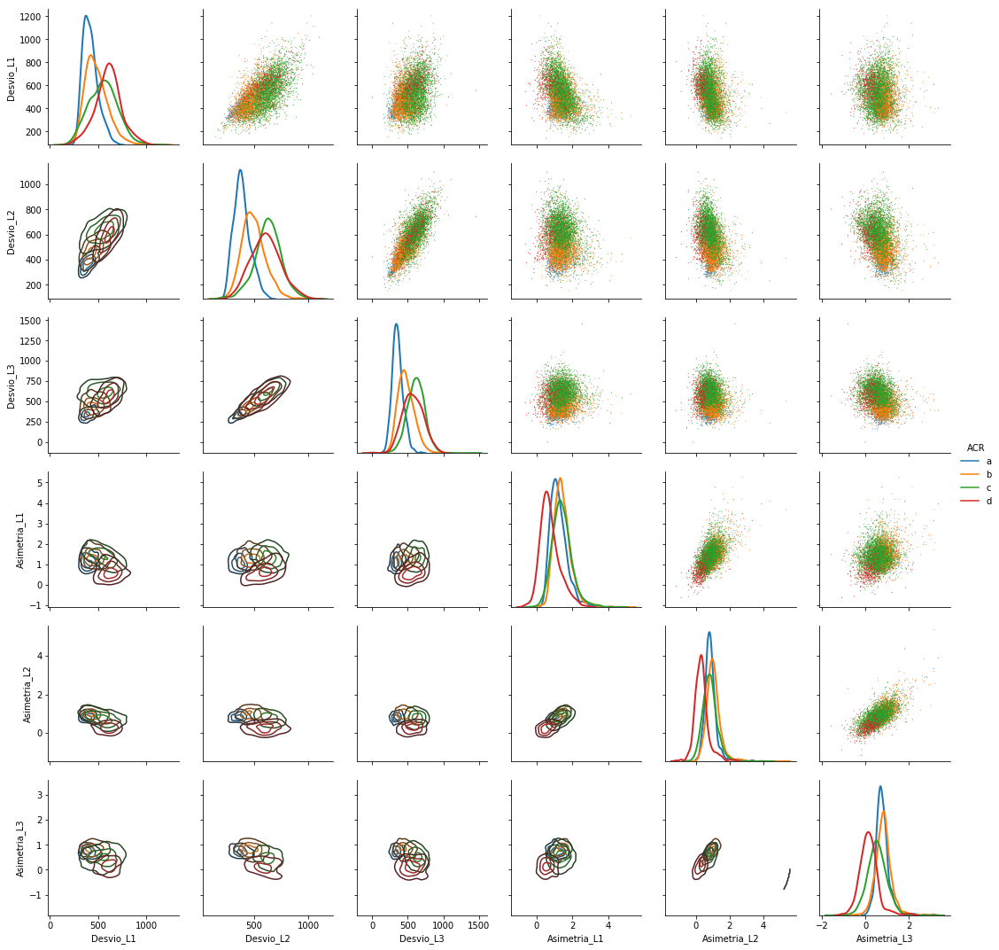

In [92]:
OF2 = Others_features[8:14]
OF2.append('ACR')
#sns.pairplot(data[OF2],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[OF2],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

De las columnas promGradiente y Relación (y también las L1,L2,L3 y L4), 
se tiene una gran cantidad de mamas tipo 'c', por lo cual dicha clase está mejor descripta a partir de estas características


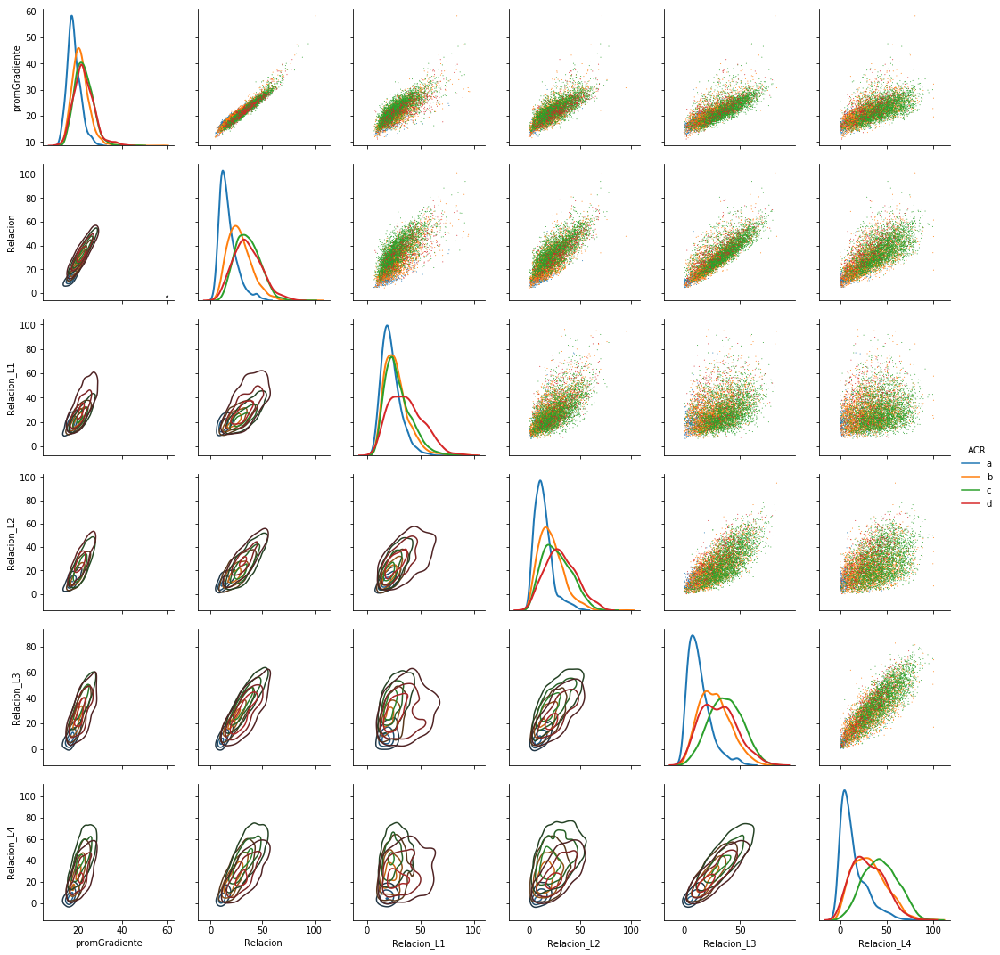

In [93]:
OF3 = Others_features[14:20]
OF3.append('ACR')
#sns.pairplot(data[OF3],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[OF3],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

De la Entropía de Permutación (EP) no podemos distinguir claramente ninguna de las clases. 
Pero de la imagen binarizada (EPBinaria) y de la RealEntropía si se logra una definición de tipos de mamas.

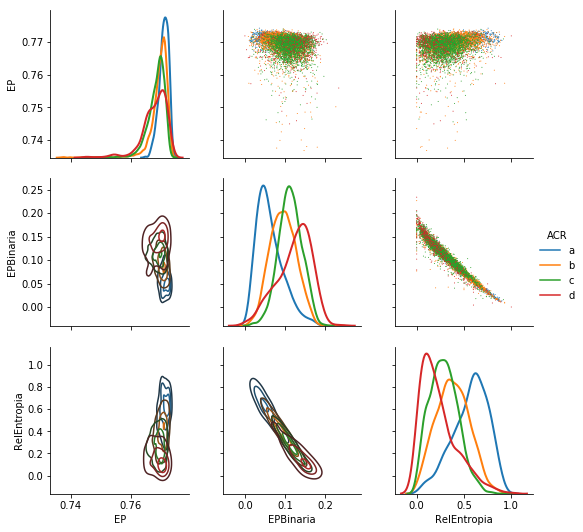

In [94]:
OF4 = Others_features[20:26]
OF4.append('ACR')
#sns.pairplot(data[OF4],hue='ACR',markers='.',plot_kws=dict(edgecolor="None",linewidth=1))
#sns.despine()

g = sns.PairGrid(data[OF4],hue='ACR',hue_order=["a","b","c","d"],despine=True,diag_sharey=False)
g.map_upper(plt.scatter,s=1,edgecolors='None')
g.map_lower(sns.kdeplot,n_levels=3)
g.map_diag(sns.kdeplot, lw=2, legend=False)
g.add_legend()
sns.despine()

**3-Evaluar si existe correlación entre las variables.**

Se evaluó la correlación entre todas las variables mediante el método de pearson y el método de spearman. ¿Será más apropiado solo considerar las correlaciones entre variables de la misma clase (i.e. separando en variables Dicom, Haralick, etc)?


**Correlaciones**

Tomaremos valores absolutos de las correlaciones de Spearman porque no podemos asumir que las características tienen distribuciones gaussianas, en las cuales se indica con verde oscuro asociaciones fuertes entre variables y en rojo aquellas con asociación débil.

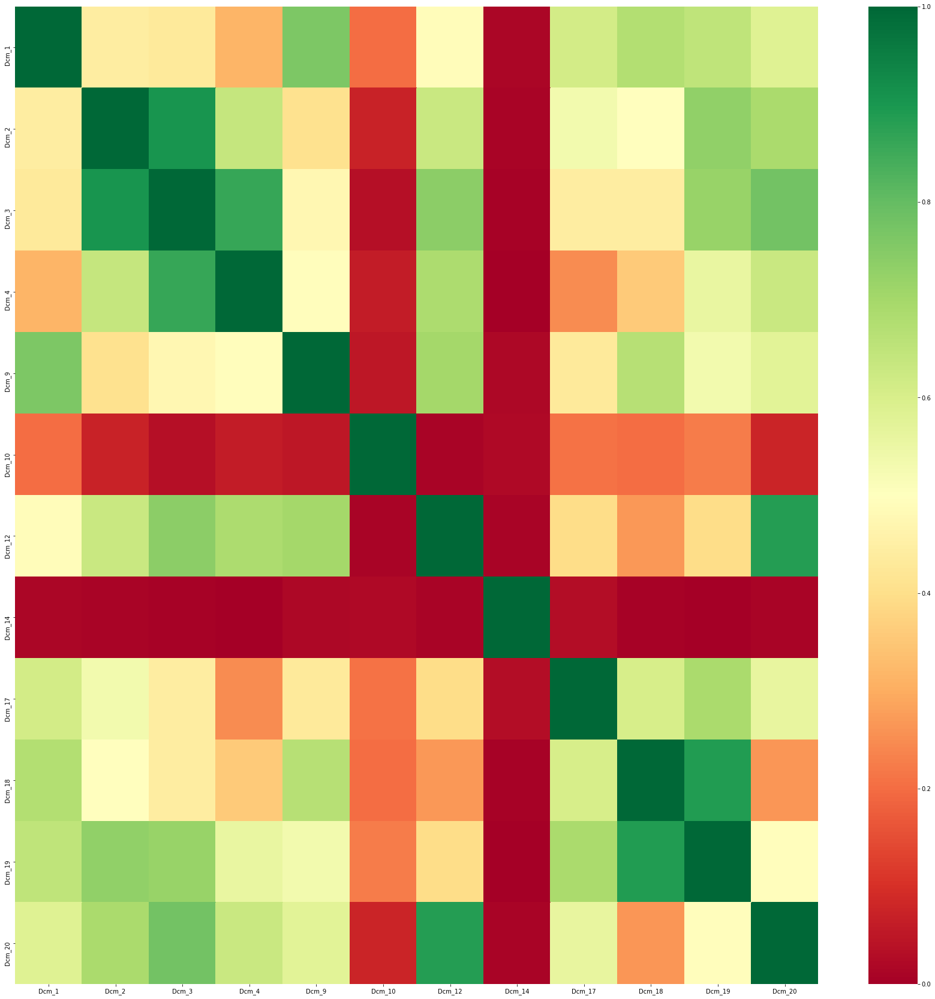

In [95]:
#Dicom_features

corr = data[Dicom_features].corr(method='spearman').abs()
f,ax = plt.subplots(1,1,figsize=(30,30))
sns.heatmap(corr,annot=False,cmap="RdYlGn",ax=ax)

Las variables con mayor correlación entre las DICOM son las Dcm_2, Dcm_3 y Dcm_4, ya que se refieren a la emisión de RX. También presentan asociación fuerte las Dcm_18 y Dcm_19 que se tratan de dosis de radiación. 
Las Dcm_10 y Dcm_14 son las que presentan menores relaciones con las demás variables. Tales se refieren a la fuerza de compresión aplicada a la mama y el ángulo del posicionador que son variables definidas por el equipamiento médico.

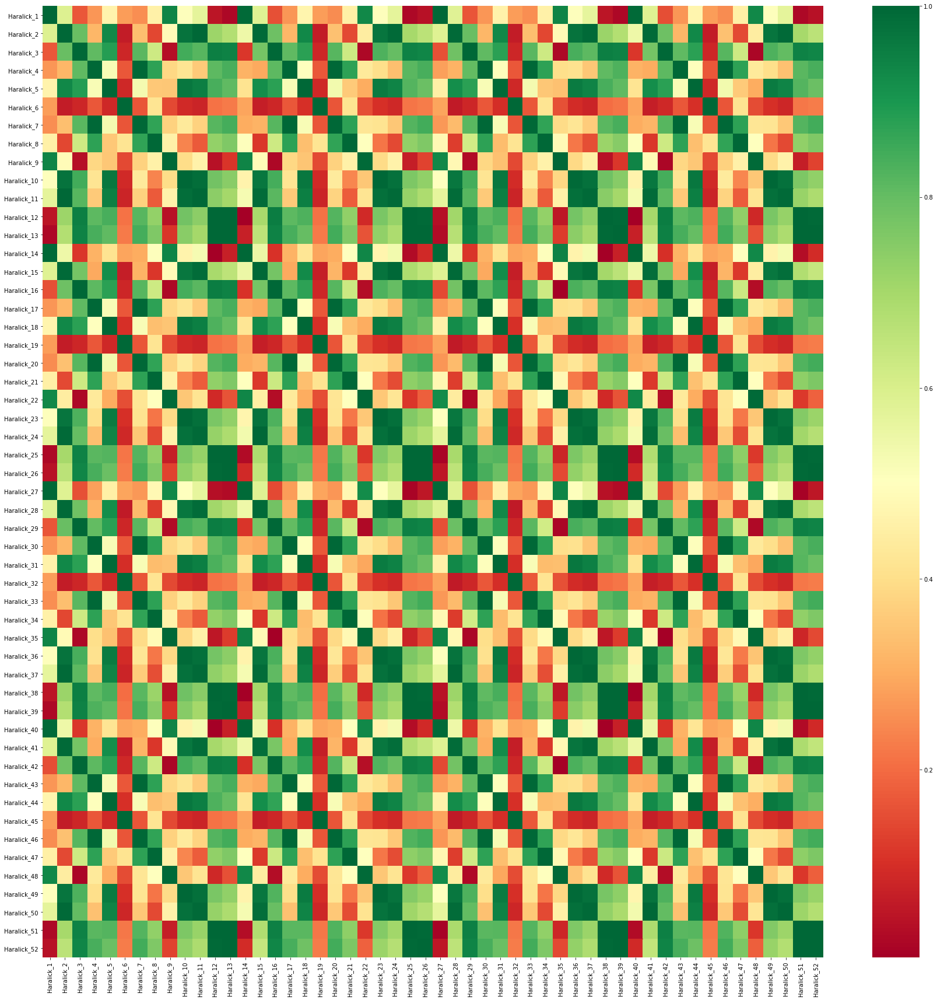

In [96]:
#Haralick_features

corr = data[Haralick_features].corr(method='spearman').abs()
f,ax = plt.subplots(1,1,figsize=(30,30))
sns.heatmap(corr,annot=False,cmap="RdYlGn",ax=ax)

En las Haralick se denota una alta correlación entre las variables y que se repite el patrón cuatro veces. 
Aquellas con menor correlación son las Haralick_6 (y sus repeticiones), la Haralick_8 con la Haralick_2 y la Haralick_9 con la Haralick_3. 
Mientras que las que tienen fuerte asociación serían las Haralick_11 y Haralick_12 con la Haralick_2, Haralick_4 con la Haralick_7. 

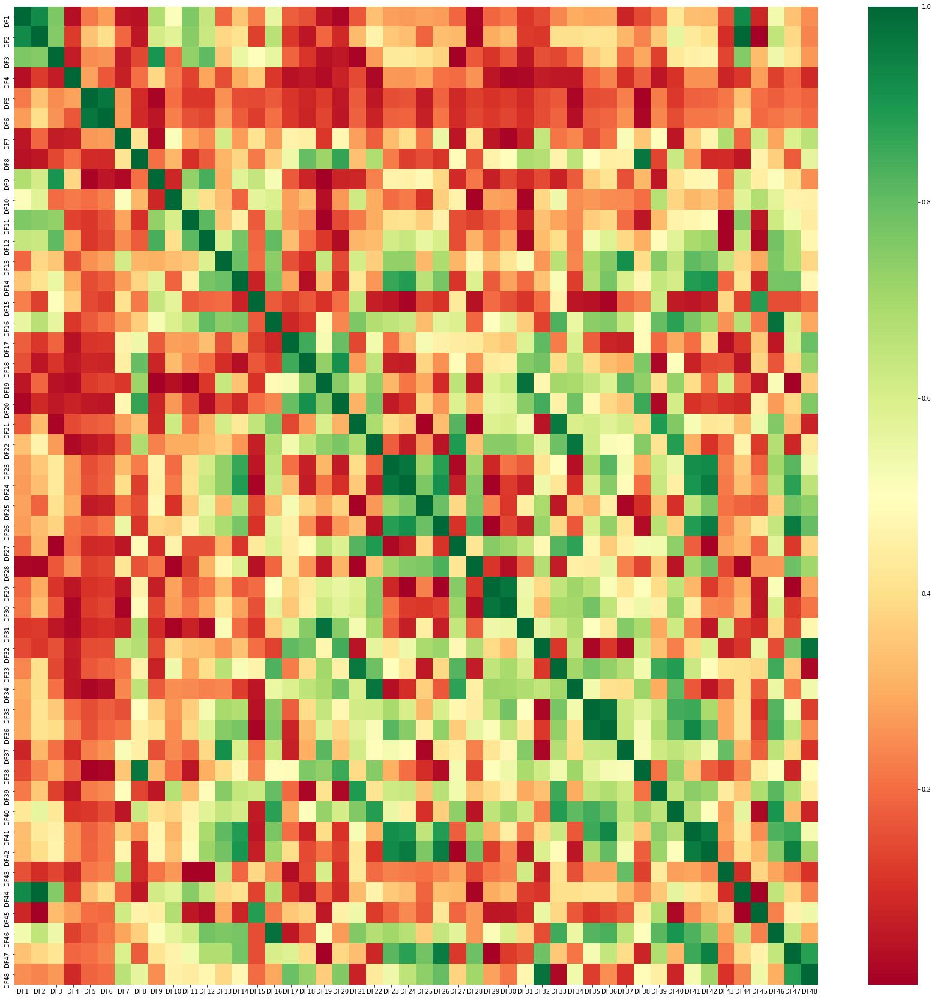

In [97]:
#Dimensión Fractal

corr = data[DF_features].corr(method='spearman').abs()
f,ax = plt.subplots(1,1,figsize=(30,30))
sns.heatmap(corr,annot=False,cmap="RdYlGn",ax=ax)

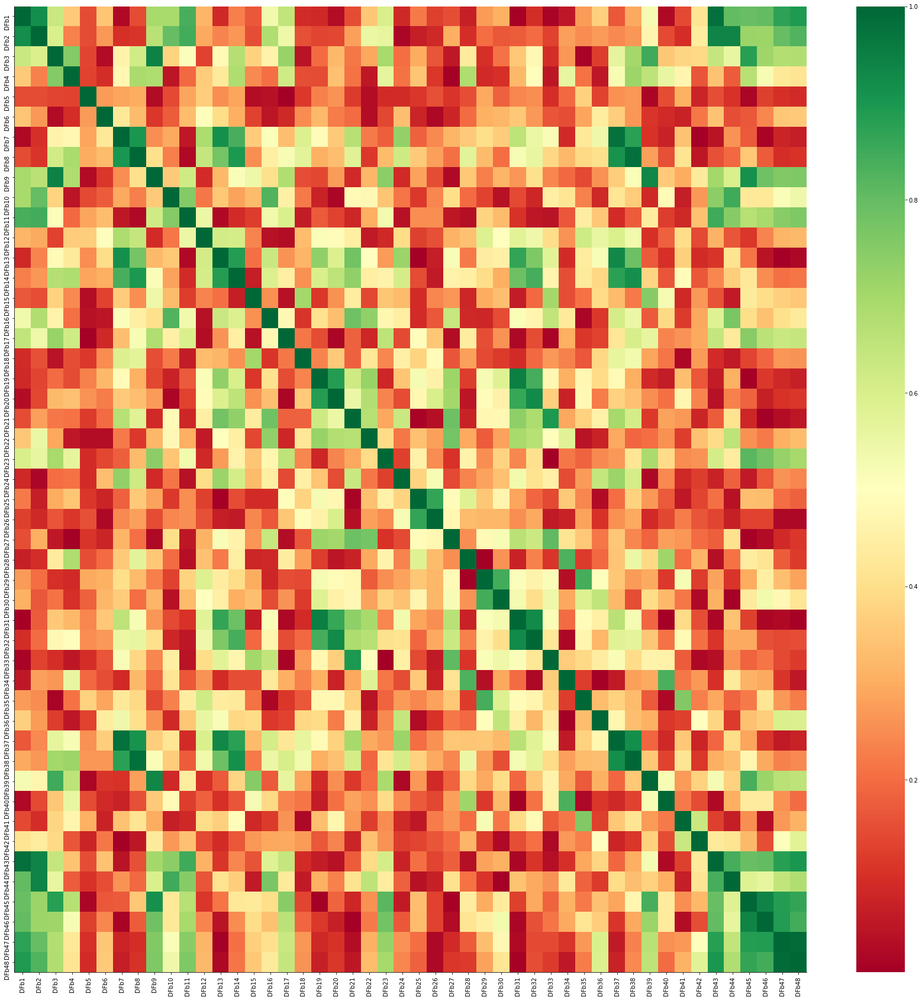

In [98]:
#Dimensión Fractal bordes

corr = data[DFb_features].corr(method='spearman').abs()
f,ax = plt.subplots(1,1,figsize=(30,30))
sns.heatmap(corr,annot=False,cmap="RdYlGn",ax=ax)
sns.despine()

De las dimensiones fractales podemos ver que en su gran mayoría no prsentan asociaciones fuertes entre ellas, con algunas excepciones. 

**Otras características**

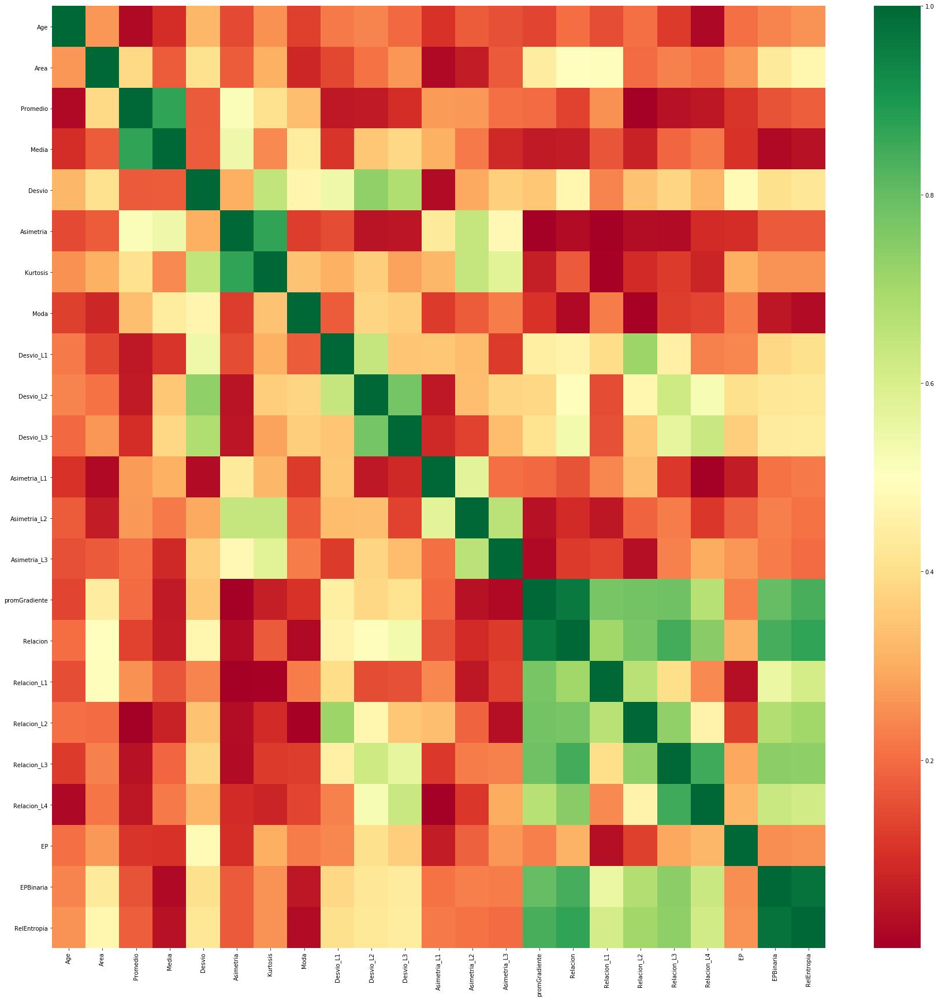

In [99]:
corr = data[Others_features].corr(method='spearman').abs()
f,ax = plt.subplots(1,1,figsize=(30,30))
sns.heatmap(corr,annot=False,cmap="RdYlGn",ax=ax)

De las demás características, no es posible distinguir correlaciones mas allá de las asociaciones lógicas dadas por las definiciones propias de los parámetros.

**4-Luego de un análisis exploratorio estime si existen variables que se muestren más relevantes para el problema final de clasificación.**

Del análisis de la correlación anterior se tomaron los pares de variables altamente correlacionadas (>0.95) y se descartó una de ellas para de esta forma disminuir la dimensión del problema.
Para la correlación de Spearman nos quedan 106 variables.
Además, se empleó la biblioteca *pandas_profiling* para comparar con nuestros resultados. Esta biblioteca haciendo un análisis similar se queda con 121 variables. Deberíamos realizar un estudio más profundo de cómo funciona esta biblioteca para determinar de donde proviene la diferencia. 



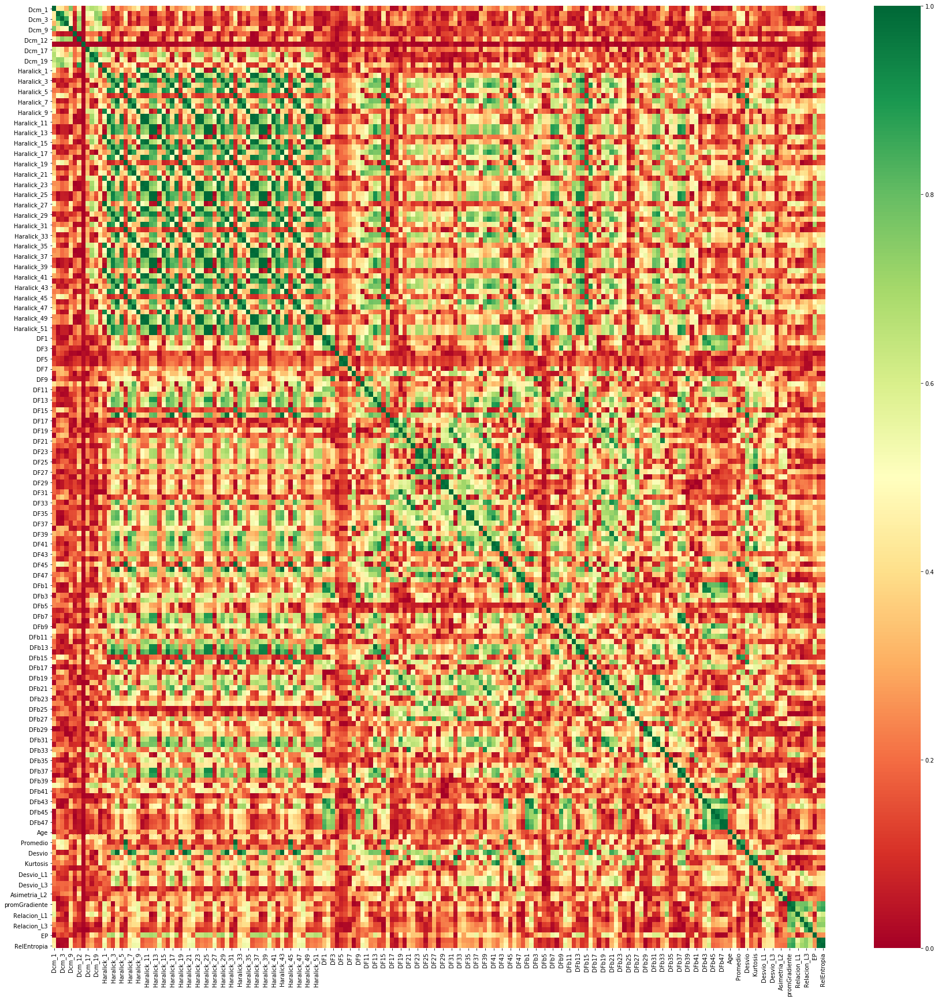

In [100]:
All_features = Dicom_features + Haralick_features + DF_features + DFb_features + Others_features

corr = data[All_features].corr(method='spearman').abs()
f,ax = plt.subplots(1,1,figsize=(30,30))
sns.heatmap(corr,annot=False,cmap="RdYlGn",ax=ax)

In [101]:
upper = corr.where(np.triu(np.ones(corr.shape),k=1).astype(np.bool))

In [102]:
_X = []
_Y = []

for column in upper.columns:
    print(column)
    for i in range(1,upper[column].shape[0]):
        if(upper[column][i] > 0.95):
            print('    ',upper[column].index[i],upper[column][i])
            _X.append(column)
            _Y.append(upper[column].index[i])

Dcm_1
Dcm_2
Dcm_3
Dcm_4
Dcm_9
Dcm_10
Dcm_12
Dcm_14
Dcm_17
Dcm_18
Dcm_19
Dcm_20
Haralick_1
Haralick_2
Haralick_3
Haralick_4
Haralick_5
Haralick_6
Haralick_7
     Haralick_4 0.9998432027322145
Haralick_8
Haralick_9
Haralick_10
     Haralick_2 0.9753446519685333
     Haralick_5 0.9662703018644598
Haralick_11
     Haralick_2 0.9976440848521293
     Haralick_5 0.9501930851942323
     Haralick_10 0.9848719394804721
Haralick_12
     Haralick_3 0.9530846738986888
Haralick_13
     Haralick_12 0.9968707660773534
Haralick_14
     Haralick_1 0.9954581689047813
Haralick_15
     Haralick_2 0.9933710177930642
     Haralick_10 0.9682779307200666
     Haralick_11 0.9903229886590171
Haralick_16
     Haralick_3 0.9978299583257729
     Haralick_12 0.9533317426799459
Haralick_17
     Haralick_4 0.9999990451900591
     Haralick_7 0.9998442496642855
Haralick_18
     Haralick_5 0.9967941028486972
     Haralick_10 0.9664846349692765
     Haralick_11 0.9507996435119913
Haralick_19
     Haralick_6 0.999999143795

     Haralick_19 0.9884116579644839
     Haralick_32 0.9883476436539216
     Haralick_45 0.9884092518434329
DF46
     Haralick_4 0.998145442421996
     Haralick_7 0.9982351716316075
     Haralick_17 0.9981475890884196
     Haralick_20 0.9982262453683208
     Haralick_30 0.9981275116315426
     Haralick_33 0.9982229249316052
     Haralick_43 0.9981516866676126
     Haralick_46 0.9982249772679742
     DF16 0.9804677465518586
DF47
     DF26 0.9582559798776992
DF48
     DF32 0.9753184214016503
DFb1
     DF1 0.968979047354325
DFb2
DFb3
     DF9 0.9517156146501087
DFb4
DFb5
DFb6
DFb7
DFb8
DFb9
     DF9 0.9797085585883912
DFb10
DFb11
DFb12
DFb13
     DF13 0.9931028375885439
DFb14
     Haralick_3 0.9724266402319378
     Haralick_12 0.9525945726102273
     Haralick_16 0.9736213514671707
     Haralick_29 0.967151676797344
     Haralick_42 0.9734007906057063
DFb15
DFb16
DFb17
DFb18
DFb19
     DF19 0.9819173364673827
DFb20
DFb21
     DF39 0.9719309382374112
DFb22
DFb23
DFb24
DFb25
DFb26
DFb27
    

La correlación de las variables puede ser bien apreciada en los respectivos gráficos de disperción de puntos, como se muestran a continuación.

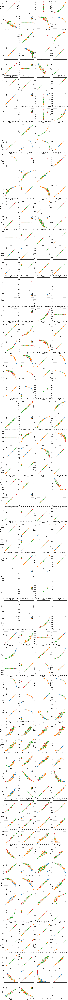

In [103]:
ntot = len(_X)
ny = 4
nx = int(ntot/ny) + 1

acr_tp = [a_cm,b_cm,c_cm,d_cm]
Names = ["a","b","c", "d"]

f, axes = plt.subplots(nx,ny,figsize=(20,20*nx/ny))

for ax,xx,yy in zip(axes.flat[:ntot],_X,_Y):
    sns.scatterplot(x=xx, y=yy, hue="ACR",hue_order=["a","b","c","d"],data=data,ax=ax)

In [104]:
threshold = 0.95
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

Campos a descartar del análisis futuro por presentar alta correlación con otros campos

In [105]:
print(len(to_drop))
print(to_drop)

77
['Haralick_7', 'Haralick_10', 'Haralick_11', 'Haralick_12', 'Haralick_13', 'Haralick_14', 'Haralick_15', 'Haralick_16', 'Haralick_17', 'Haralick_18', 'Haralick_19', 'Haralick_20', 'Haralick_21', 'Haralick_22', 'Haralick_23', 'Haralick_24', 'Haralick_25', 'Haralick_26', 'Haralick_27', 'Haralick_28', 'Haralick_29', 'Haralick_30', 'Haralick_31', 'Haralick_32', 'Haralick_33', 'Haralick_34', 'Haralick_35', 'Haralick_36', 'Haralick_37', 'Haralick_38', 'Haralick_39', 'Haralick_40', 'Haralick_41', 'Haralick_42', 'Haralick_43', 'Haralick_44', 'Haralick_45', 'Haralick_46', 'Haralick_47', 'Haralick_48', 'Haralick_49', 'Haralick_50', 'Haralick_51', 'Haralick_52', 'DF6', 'DF16', 'DF24', 'DF30', 'DF31', 'DF33', 'DF34', 'DF36', 'DF38', 'DF42', 'DF44', 'DF45', 'DF46', 'DF47', 'DF48', 'DFb1', 'DFb3', 'DFb9', 'DFb13', 'DFb14', 'DFb19', 'DFb21', 'DFb27', 'DFb37', 'DFb38', 'DFb43', 'DFb48', 'Promedio', 'Desvio', 'Asimetria', 'Kurtosis', 'Relacion', 'RelEntropia']


In [106]:
_data = data[All_features]
_data = _data.drop(to_drop,axis=1)

In [112]:
print("Tamaño original: \n","   Número de imágenes: %i\n" % data[All_features].shape[0], "   Número de campos %i" % data[All_features].shape[1])
print("Tamaño final: \n","   Número de imágenes: %i\n" % _data.shape[0], "   Número de campos %i" % _data.shape[1])

Tamaño original: 
    Número de imágenes: 6345
    Número de campos 183
Tamaño final: 
    Número de imágenes: 6345
    Número de campos 106


In [ ]:
#import pandas_profiling as pp

In [ ]:
#pr = pp.ProfileReport(data[All_features],bins=50,correlation_threshold=0.95)

In [ ]:
#pr.to_file(outputfile="output.html")